In [1]:
import numpy as np
import copy
import matplotlib.pyplot as plt
import pickle
import random
import torch
from utils import torch_from_numpy
import datetime

%matplotlib inline


bif_c = 0.1
num_iter_max=200000
alpha=0.2
# alpha=0.5
# alpha=0.8 # predict diverge
# vae_lr=1e-5
vae_lr=5e-4
ratio_lr=5e-4
ratio_early=100
env_name = 'CustomPendulum-v0'
figfilenamehead = "fig_policy_evaluation_"

loss_list = []
normalized_loss_list = []

In [2]:
import gym
import custom_gym
env = gym.make(env_name)

seed = 0
env.seed(seed)
env.action_space.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)

s_dim = env.reset().flatten().shape[0]
a_dim = env.action_space.sample().flatten().shape[0]
z_dim = 1
print(s_dim, a_dim, z_dim)



2 1 1


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/proxima-hishinuma/anaconda3/

In [3]:


from sac import SAC
agent = SAC(env.observation_space.shape[0], env.action_space)
agent.load_checkpoint(ckpt_path="checkpoints/sac_checkpoint_custom_pendulum_mdp_")


offline_data = pickle.load(open("offline_data.pkl","rb"))
debug_info = pickle.load(open("offline_data_debug_info.pkl","rb"))
debug_info = np.array(debug_info)

Loading models from checkpoints/sac_checkpoint_custom_pendulum_mdp_


In [4]:
args_init_dict = {"offline_data": offline_data,
             "s_dim": s_dim,
             "a_dim": a_dim,
             "z_dim": z_dim,
#              "policy":agent.select_action,
             "mdp_policy":agent.policy.my_np_select_action,
             "bamdp_policy":None,
                  "debug_info":debug_info,
                  "env" : env}
# import vi_base
# vi = vi_base.baseVI(args_init_dict)
import vi_iw
iwvi = vi_iw.iwVI(args_init_dict)

iwvi.load_base()
iwvi.update_mulogvar_offlinedata()

load vi_base_ckpt


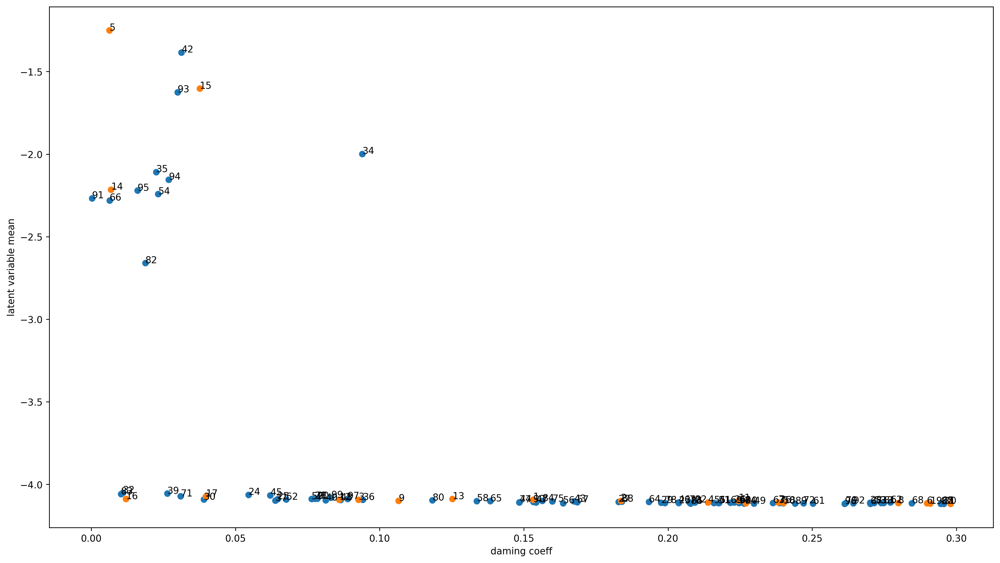

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [5]:
plt.figure(figsize=(18,10), dpi=250)
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()
plt.xlabel("daming coeff")
plt.ylabel("latent variable mean")

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([-0.05,0.35])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter0.png")
plt.savefig(figfilenamehead+"damping_latent_iter0.eps")
plt.savefig(figfilenamehead+"damping_latent_iter0.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.xlim([0.06,0.14])
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [6]:
iwvi.get_real_rollout_mdppolicy_data()

0  1  

/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(done, (bool, np.bool8)):
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:141: UserWarning: WARN: The obs returned by the `step()` method was expecting numpy array dtype to be float32, actual type: float64
  logger.warn(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:165: UserWarning: WARN: The obs returned by the `step()` method is not within the observ

2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [7]:
# fig = plt.figure(figsize=(18,10))
# ax_list = []
# for i in range(50):
#     ax_list.append(fig.add_subplot(5, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1]) 
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1]) 
# print("オフラインデータvs実環境方策rollout")

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  predict diverge [   7.74578972 -150.78676298]
43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  predict 

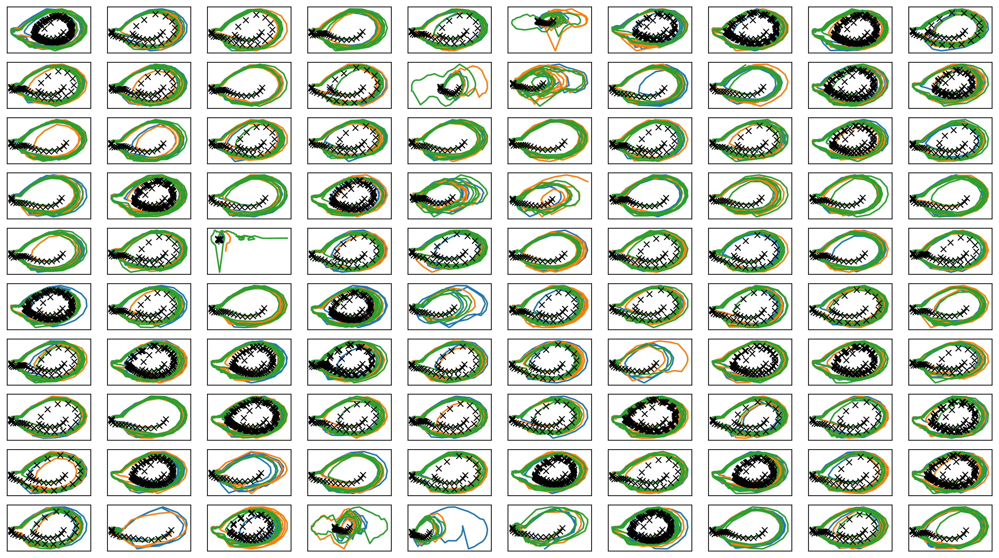

In [8]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter0.png")
plt.savefig(figfilenamehead+"joint_iter0.eps")
plt.savefig(figfilenamehead+"joint_iter0.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

In [9]:
print(datetime.datetime.now())

2023-03-28 05:43:28.988240


# Iter 1

In [10]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [11]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 1.37738  validloss 1.46790±0.00000  bestvalidloss 1.46790  last_update 0
train: iter 1  trainloss 1.17147  validloss 1.29218±0.00000  bestvalidloss 1.29218  last_update 0
train: iter 2  trainloss 0.96669  validloss 1.06004±0.00000  bestvalidloss 1.06004  last_update 0
train: iter 3  trainloss 0.85670  validloss 0.91366±0.00000  bestvalidloss 0.91366  last_update 0
train: iter 4  trainloss 0.79389  validloss 0.83765±0.00000  bestvalidloss 0.83765  last_update 0
train: iter 5  trainloss 0.75190  validloss 0.78235±0.00000  bestvalidloss 0.78235  last_update 0
train: iter 6  trainloss 0.71678  validloss 0.73941±0.00000  bestvalidloss 0.73941  last_update 0
train: iter 7  trainloss 0.68455  validloss 0.69833±0.00000  bestvalidloss 0.69833  last_update 0
train: iter 8  trainloss 0.65374  validloss 0.66352±0.00000  bestvalidloss 0.66352  last_update 0
train: iter 9  trainloss 0.62246  validloss 0.62997±0.00000  bestvalidloss 0.62997  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.27809  validloss 0.30806±0.00000  bestvalidloss 0.30806  last_update 0
train: iter 85  trainloss 0.27601  validloss 0.30912±0.00000  bestvalidloss 0.30806  last_update 1
train: iter 86  trainloss 0.27429  validloss 0.30743±0.00000  bestvalidloss 0.30743  last_update 0
train: iter 87  trainloss 0.27407  validloss 0.30674±0.00000  bestvalidloss 0.30674  last_update 0
train: iter 88  trainloss 0.27275  validloss 0.30663±0.00000  bestvalidloss 0.30663  last_update 0
train: iter 89  trainloss 0.27475  validloss 0.30631±0.00000  bestvalidloss 0.30631  last_update 0
train: iter 90  trainloss 0.27342  validloss 0.31157±0.00000  bestvalidloss 0.30631  last_update 1
train: iter 91  trainloss 0.27173  validloss 0.30663±0.00000  bestvalidloss 0.30631  last_update 2
train: iter 92  trainloss 0.27178  validloss 0.30466±0.00000  bestvalidloss 0.30466  last_update 0
train: iter 93  trainloss 0.26936  validloss 0.30305±0.00000  bestvalidloss 0.30305  last_update 0
train: ite

train: iter 169  trainloss 0.24988  validloss 0.27907±0.00000  bestvalidloss 0.27896  last_update 3
train: iter 170  trainloss 0.24708  validloss 0.27987±0.00000  bestvalidloss 0.27896  last_update 4
train: iter 171  trainloss 0.24509  validloss 0.27969±0.00000  bestvalidloss 0.27896  last_update 5
train: iter 172  trainloss 0.24705  validloss 0.27870±0.00000  bestvalidloss 0.27870  last_update 0
train: iter 173  trainloss 0.24594  validloss 0.27827±0.00000  bestvalidloss 0.27827  last_update 0
train: iter 174  trainloss 0.24585  validloss 0.27779±0.00000  bestvalidloss 0.27779  last_update 0
train: iter 175  trainloss 0.24712  validloss 0.27944±0.00000  bestvalidloss 0.27779  last_update 1
train: iter 176  trainloss 0.24715  validloss 0.27717±0.00000  bestvalidloss 0.27717  last_update 0
train: iter 177  trainloss 0.24611  validloss 0.28180±0.00000  bestvalidloss 0.27717  last_update 1
train: iter 178  trainloss 0.24589  validloss 0.27642±0.00000  bestvalidloss 0.27642  last_update 0


train: iter 251  trainloss 0.23404  validloss 0.26684±0.00000  bestvalidloss 0.26657  last_update 13
train: iter 252  trainloss 0.23404  validloss 0.26671±0.00000  bestvalidloss 0.26657  last_update 14
train: iter 253  trainloss 0.23326  validloss 0.26638±0.00000  bestvalidloss 0.26638  last_update 0
train: iter 254  trainloss 0.23466  validloss 0.26621±0.00000  bestvalidloss 0.26621  last_update 0
train: iter 255  trainloss 0.23271  validloss 0.26956±0.00000  bestvalidloss 0.26621  last_update 1
train: iter 256  trainloss 0.23591  validloss 0.27625±0.00000  bestvalidloss 0.26621  last_update 2
train: iter 257  trainloss 0.23246  validloss 0.26533±0.00000  bestvalidloss 0.26533  last_update 0
train: iter 258  trainloss 0.23193  validloss 0.26702±0.00000  bestvalidloss 0.26533  last_update 1
train: iter 259  trainloss 0.23230  validloss 0.26529±0.00000  bestvalidloss 0.26529  last_update 0
train: iter 260  trainloss 0.23255  validloss 0.26679±0.00000  bestvalidloss 0.26529  last_update 

train: iter 333  trainloss 0.22645  validloss 0.26604±0.00000  bestvalidloss 0.26094  last_update 7
train: iter 334  trainloss 0.22793  validloss 0.26083±0.00000  bestvalidloss 0.26083  last_update 0
train: iter 335  trainloss 0.22360  validloss 0.26163±0.00000  bestvalidloss 0.26083  last_update 1
train: iter 336  trainloss 0.22436  validloss 0.26075±0.00000  bestvalidloss 0.26075  last_update 0
train: iter 337  trainloss 0.22455  validloss 0.26575±0.00000  bestvalidloss 0.26075  last_update 1
train: iter 338  trainloss 0.22861  validloss 0.27207±0.00000  bestvalidloss 0.26075  last_update 2
train: iter 339  trainloss 0.22590  validloss 0.26037±0.00000  bestvalidloss 0.26037  last_update 0
train: iter 340  trainloss 0.22841  validloss 0.26180±0.00000  bestvalidloss 0.26037  last_update 1
train: iter 341  trainloss 0.22495  validloss 0.26173±0.00000  bestvalidloss 0.26037  last_update 2
train: iter 342  trainloss 0.22466  validloss 0.26202±0.00000  bestvalidloss 0.26037  last_update 3


train: iter 415  trainloss 0.21882  validloss 0.26105±0.00000  bestvalidloss 0.25809  last_update 17
train: iter 416  trainloss 0.21858  validloss 0.26269±0.00000  bestvalidloss 0.25809  last_update 18
train: iter 417  trainloss 0.21812  validloss 0.26233±0.00000  bestvalidloss 0.25809  last_update 19
train: iter 418  trainloss 0.22021  validloss 0.26074±0.00000  bestvalidloss 0.25809  last_update 20
train: iter 419  trainloss 0.21806  validloss 0.26128±0.00000  bestvalidloss 0.25809  last_update 21
train: iter 420  trainloss 0.21863  validloss 0.25906±0.00000  bestvalidloss 0.25809  last_update 22
train: iter 421  trainloss 0.21760  validloss 0.25899±0.00000  bestvalidloss 0.25809  last_update 23
train: iter 422  trainloss 0.22087  validloss 0.25823±0.00000  bestvalidloss 0.25809  last_update 24
train: iter 423  trainloss 0.21905  validloss 0.25996±0.00000  bestvalidloss 0.25809  last_update 25
train: iter 424  trainloss 0.21939  validloss 0.26194±0.00000  bestvalidloss 0.25809  last_

train: iter 497  trainloss 0.21277  validloss 0.25689±0.00000  bestvalidloss 0.25633  last_update 39
train: iter 498  trainloss 0.21206  validloss 0.25752±0.00000  bestvalidloss 0.25633  last_update 40
train: iter 499  trainloss 0.21360  validloss 0.25963±0.00000  bestvalidloss 0.25633  last_update 41
train: iter 500  trainloss 0.21264  validloss 0.26047±0.00000  bestvalidloss 0.25633  last_update 42
train: iter 501  trainloss 0.21268  validloss 0.25892±0.00000  bestvalidloss 0.25633  last_update 43
train: iter 502  trainloss 0.21232  validloss 0.25724±0.00000  bestvalidloss 0.25633  last_update 44
train: iter 503  trainloss 0.21470  validloss 0.25715±0.00000  bestvalidloss 0.25633  last_update 45
train: iter 504  trainloss 0.21566  validloss 0.26453±0.00000  bestvalidloss 0.25633  last_update 46
train: iter 505  trainloss 0.21176  validloss 0.26028±0.00000  bestvalidloss 0.25633  last_update 47
train: iter 506  trainloss 0.21670  validloss 0.26233±0.00000  bestvalidloss 0.25633  last_

train: iter 579  trainloss 0.20808  validloss 0.25663±0.00000  bestvalidloss 0.25615  last_update 53
train: iter 580  trainloss 0.20955  validloss 0.25865±0.00000  bestvalidloss 0.25615  last_update 54
train: iter 581  trainloss 0.21213  validloss 0.25866±0.00000  bestvalidloss 0.25615  last_update 55
train: iter 582  trainloss 0.20765  validloss 0.25714±0.00000  bestvalidloss 0.25615  last_update 56
train: iter 583  trainloss 0.21056  validloss 0.26123±0.00000  bestvalidloss 0.25615  last_update 57
train: iter 584  trainloss 0.20914  validloss 0.25998±0.00000  bestvalidloss 0.25615  last_update 58
train: iter 585  trainloss 0.20977  validloss 0.25673±0.00000  bestvalidloss 0.25615  last_update 59
train: iter 586  trainloss 0.21139  validloss 0.26155±0.00000  bestvalidloss 0.25615  last_update 60
train: iter 587  trainloss 0.20846  validloss 0.25716±0.00000  bestvalidloss 0.25615  last_update 61
train: iter 588  trainloss 0.20756  validloss 0.25690±0.00000  bestvalidloss 0.25615  last_

train: iter 661  trainloss 0.20733  validloss 0.26243±0.00000  bestvalidloss 0.25475  last_update 20
train: iter 662  trainloss 0.20610  validloss 0.26021±0.00000  bestvalidloss 0.25475  last_update 21
train: iter 663  trainloss 0.20681  validloss 0.25692±0.00000  bestvalidloss 0.25475  last_update 22
train: iter 664  trainloss 0.20762  validloss 0.25654±0.00000  bestvalidloss 0.25475  last_update 23
train: iter 665  trainloss 0.20621  validloss 0.25588±0.00000  bestvalidloss 0.25475  last_update 24
train: iter 666  trainloss 0.20635  validloss 0.26068±0.00000  bestvalidloss 0.25475  last_update 25
train: iter 667  trainloss 0.20512  validloss 0.25492±0.00000  bestvalidloss 0.25475  last_update 26
train: iter 668  trainloss 0.20498  validloss 0.25580±0.00000  bestvalidloss 0.25475  last_update 27
train: iter 669  trainloss 0.20634  validloss 0.25494±0.00000  bestvalidloss 0.25475  last_update 28
train: iter 670  trainloss 0.20319  validloss 0.25557±0.00000  bestvalidloss 0.25475  last_

train: iter 743  trainloss 0.20693  validloss 0.25521±0.00000  bestvalidloss 0.25274  last_update 1
train: iter 744  trainloss 0.20236  validloss 0.25675±0.00000  bestvalidloss 0.25274  last_update 2
train: iter 745  trainloss 0.20545  validloss 0.25751±0.00000  bestvalidloss 0.25274  last_update 3
train: iter 746  trainloss 0.20542  validloss 0.25623±0.00000  bestvalidloss 0.25274  last_update 4
train: iter 747  trainloss 0.20421  validloss 0.25348±0.00000  bestvalidloss 0.25274  last_update 5
train: iter 748  trainloss 0.20452  validloss 0.25456±0.00000  bestvalidloss 0.25274  last_update 6
train: iter 749  trainloss 0.20435  validloss 0.25549±0.00000  bestvalidloss 0.25274  last_update 7
train: iter 750  trainloss 0.20218  validloss 0.25579±0.00000  bestvalidloss 0.25274  last_update 8
train: iter 751  trainloss 0.20346  validloss 0.25850±0.00000  bestvalidloss 0.25274  last_update 9
train: iter 752  trainloss 0.20329  validloss 0.25300±0.00000  bestvalidloss 0.25274  last_update 10

train: iter 827  trainloss 0.20150  validloss 0.25239±0.00000  bestvalidloss 0.25140  last_update 24
train: iter 828  trainloss 0.20138  validloss 0.25248±0.00000  bestvalidloss 0.25140  last_update 25
train: iter 829  trainloss 0.20081  validloss 0.25333±0.00000  bestvalidloss 0.25140  last_update 26
train: iter 830  trainloss 0.20057  validloss 0.25675±0.00000  bestvalidloss 0.25140  last_update 27
train: iter 831  trainloss 0.20116  validloss 0.25674±0.00000  bestvalidloss 0.25140  last_update 28
train: iter 832  trainloss 0.20222  validloss 0.25582±0.00000  bestvalidloss 0.25140  last_update 29
train: iter 833  trainloss 0.20187  validloss 0.25438±0.00000  bestvalidloss 0.25140  last_update 30
train: iter 834  trainloss 0.20122  validloss 0.25409±0.00000  bestvalidloss 0.25140  last_update 31
train: iter 835  trainloss 0.20373  validloss 0.25309±0.00000  bestvalidloss 0.25140  last_update 32
train: iter 836  trainloss 0.20641  validloss 0.26443±0.00000  bestvalidloss 0.25140  last_

train: iter 910  trainloss 0.20010  validloss 0.25046±0.00000  bestvalidloss 0.25017  last_update 10
train: iter 911  trainloss 0.19921  validloss 0.25184±0.00000  bestvalidloss 0.25017  last_update 11
train: iter 912  trainloss 0.20042  validloss 0.25241±0.00000  bestvalidloss 0.25017  last_update 12
train: iter 913  trainloss 0.19931  validloss 0.25609±0.00000  bestvalidloss 0.25017  last_update 13
train: iter 914  trainloss 0.19941  validloss 0.25331±0.00000  bestvalidloss 0.25017  last_update 14
train: iter 915  trainloss 0.19924  validloss 0.25019±0.00000  bestvalidloss 0.25017  last_update 15
train: iter 916  trainloss 0.19928  validloss 0.25155±0.00000  bestvalidloss 0.25017  last_update 16
train: iter 917  trainloss 0.19943  validloss 0.26640±0.00000  bestvalidloss 0.25017  last_update 17
train: iter 918  trainloss 0.20034  validloss 0.25321±0.00000  bestvalidloss 0.25017  last_update 18
train: iter 919  trainloss 0.20050  validloss 0.25100±0.00000  bestvalidloss 0.25017  last_

train: iter 992  trainloss 0.19783  validloss 0.25340±0.00000  bestvalidloss 0.24946  last_update 30
train: iter 993  trainloss 0.19711  validloss 0.25256±0.00000  bestvalidloss 0.24946  last_update 31
train: iter 994  trainloss 0.19752  validloss 0.25165±0.00000  bestvalidloss 0.24946  last_update 32
train: iter 995  trainloss 0.19644  validloss 0.25430±0.00000  bestvalidloss 0.24946  last_update 33
train: iter 996  trainloss 0.19653  validloss 0.25286±0.00000  bestvalidloss 0.24946  last_update 34
train: iter 997  trainloss 0.19775  validloss 0.25372±0.00000  bestvalidloss 0.24946  last_update 35
train: iter 998  trainloss 0.19742  validloss 0.25198±0.00000  bestvalidloss 0.24946  last_update 36
train: iter 999  trainloss 0.19686  validloss 0.25253±0.00000  bestvalidloss 0.24946  last_update 37
train: iter 1000  trainloss 0.19639  validloss 0.25290±0.00000  bestvalidloss 0.24946  last_update 38
train: iter 1001  trainloss 0.19726  validloss 0.25171±0.00000  bestvalidloss 0.24946  las

train: iter 1074  trainloss 0.19540  validloss 0.25323±0.00000  bestvalidloss 0.24740  last_update 24
train: iter 1075  trainloss 0.19649  validloss 0.25286±0.00000  bestvalidloss 0.24740  last_update 25
train: iter 1076  trainloss 0.19464  validloss 0.25213±0.00000  bestvalidloss 0.24740  last_update 26
train: iter 1077  trainloss 0.19847  validloss 0.25259±0.00000  bestvalidloss 0.24740  last_update 27
train: iter 1078  trainloss 0.19721  validloss 0.26283±0.00000  bestvalidloss 0.24740  last_update 28
train: iter 1079  trainloss 0.19714  validloss 0.25715±0.00000  bestvalidloss 0.24740  last_update 29
train: iter 1080  trainloss 0.19417  validloss 0.24940±0.00000  bestvalidloss 0.24740  last_update 30
train: iter 1081  trainloss 0.19583  validloss 0.25565±0.00000  bestvalidloss 0.24740  last_update 31
train: iter 1082  trainloss 0.19587  validloss 0.25832±0.00000  bestvalidloss 0.24740  last_update 32
train: iter 1083  trainloss 0.19480  validloss 0.25129±0.00000  bestvalidloss 0.24

In [12]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -167.2098543000221
valid_loss:  -204.67204662799833
train_loss:  -270.53174247920515
valid_loss:  -251.02886200070378


1e-08 1000.0


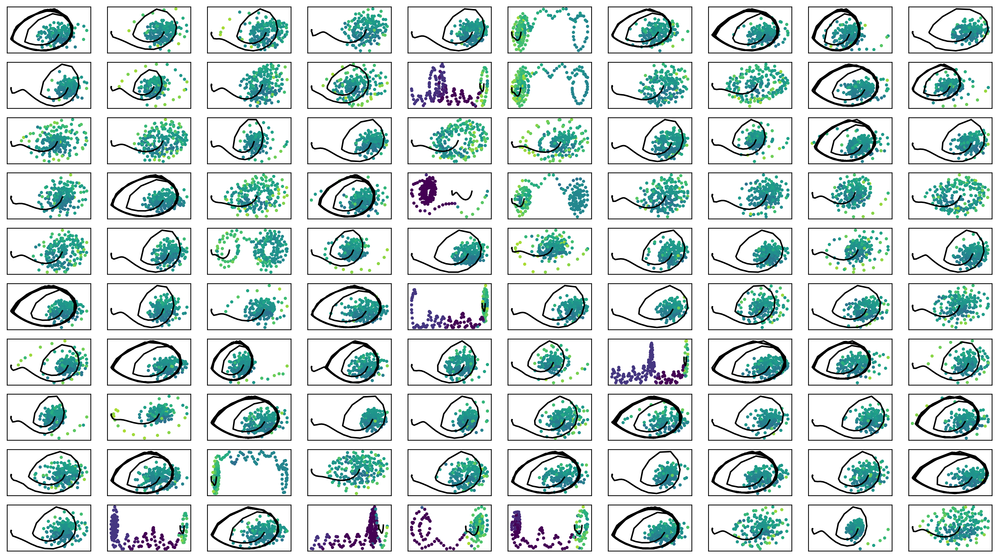

In [13]:

def f(x):
#     return x
    return np.log10(x)

fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter1.png")

In [14]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [15]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [16]:
# for i in range(100):
#     print(i, " ", end="")
#     fig = plt.figure(figsize=(16,10), dpi=150)
#     fig.patch.set_facecolor('white')
#     plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#                vmin=-8, vmax=3
#                )
#     plt.colorbar()
#     plt.savefig("ratio"+str(i)+".png")
#     plt.close()

train_weighted_vae: enc_dec
train: iter 0  trainloss -257.29617  validloss -252.00324±0.00000  bestvalidloss -252.00324  last_update 0
train: iter 1  trainloss -249.83107  validloss -246.68223±0.00000  bestvalidloss -252.00324  last_update 1
train: iter 2  trainloss -265.93629  validloss -249.48743±0.00000  bestvalidloss -252.00324  last_update 2
train: iter 3  trainloss -266.70155  validloss -253.32045±0.00000  bestvalidloss -253.32045  last_update 0
train: iter 4  trainloss -266.73934  validloss -248.75334±0.00000  bestvalidloss -253.32045  last_update 1
train: iter 5  trainloss -265.92786  validloss -249.94432±0.00000  bestvalidloss -253.32045  last_update 2
train: iter 6  trainloss -269.60763  validloss -256.71406±0.00000  bestvalidloss -256.71406  last_update 0
train: iter 7  trainloss -268.37147  validloss -250.91748±0.00000  bestvalidloss -256.71406  last_update 1
train: iter 8  trainloss -265.83839  validloss -243.72419±0.00000  bestvalidloss -256.71406  last_update 2
train: it

train: iter 76  trainloss -298.90558  validloss -279.08308±0.00000  bestvalidloss -282.61108  last_update 7
train: iter 77  trainloss -301.04616  validloss -276.92334±0.00000  bestvalidloss -282.61108  last_update 8
train: iter 78  trainloss -297.14857  validloss -280.92097±0.00000  bestvalidloss -282.61108  last_update 9
train: iter 79  trainloss -298.25784  validloss -286.08637±0.00000  bestvalidloss -286.08637  last_update 0
train: iter 80  trainloss -302.93436  validloss -273.34923±0.00000  bestvalidloss -286.08637  last_update 1
train: iter 81  trainloss -299.56590  validloss -281.41347±0.00000  bestvalidloss -286.08637  last_update 2
train: iter 82  trainloss -296.91066  validloss -277.92883±0.00000  bestvalidloss -286.08637  last_update 3
train: iter 83  trainloss -291.43812  validloss -276.15956±0.00000  bestvalidloss -286.08637  last_update 4
train: iter 84  trainloss -301.32543  validloss -257.36526±0.00000  bestvalidloss -286.08637  last_update 5
train: iter 85  trainloss -3

train: iter 152  trainloss -333.91455  validloss -291.83220±0.00000  bestvalidloss -309.70334  last_update 6
train: iter 153  trainloss -334.96157  validloss -296.67446±0.00000  bestvalidloss -309.70334  last_update 7
train: iter 154  trainloss -328.52717  validloss -292.55452±0.00000  bestvalidloss -309.70334  last_update 8
train: iter 155  trainloss -336.57555  validloss -299.81174±0.00000  bestvalidloss -309.70334  last_update 9
train: iter 156  trainloss -325.90544  validloss -305.96747±0.00000  bestvalidloss -309.70334  last_update 10
train: iter 157  trainloss -339.06535  validloss -304.93026±0.00000  bestvalidloss -309.70334  last_update 11
train: iter 158  trainloss -330.55825  validloss -301.84799±0.00000  bestvalidloss -309.70334  last_update 12
train: iter 159  trainloss -336.67843  validloss -310.20424±0.00000  bestvalidloss -310.20424  last_update 0
train: iter 160  trainloss -336.16622  validloss -311.04713±0.00000  bestvalidloss -311.04713  last_update 0
train: iter 161 

train: iter 227  trainloss -375.03502  validloss -339.79664±0.00000  bestvalidloss -340.30803  last_update 4
train: iter 228  trainloss -379.10599  validloss -336.37185±0.00000  bestvalidloss -340.30803  last_update 5
train: iter 229  trainloss -367.32070  validloss -352.45631±0.00000  bestvalidloss -352.45631  last_update 0
train: iter 230  trainloss -375.88315  validloss -347.00246±0.00000  bestvalidloss -352.45631  last_update 1
train: iter 231  trainloss -373.99906  validloss -360.21954±0.00000  bestvalidloss -360.21954  last_update 0
train: iter 232  trainloss -381.84763  validloss -361.22657±0.00000  bestvalidloss -361.22657  last_update 0
train: iter 233  trainloss -387.33047  validloss -353.62161±0.00000  bestvalidloss -361.22657  last_update 1
train: iter 234  trainloss -390.80200  validloss -362.83707±0.00000  bestvalidloss -362.83707  last_update 0
train: iter 235  trainloss -391.33114  validloss -359.74029±0.00000  bestvalidloss -362.83707  last_update 1
train: iter 236  tr

train: iter 303  trainloss -431.11760  validloss -405.66639±0.00000  bestvalidloss -417.09460  last_update 2
train: iter 304  trainloss -434.13432  validloss -401.50109±0.00000  bestvalidloss -417.09460  last_update 3
train: iter 305  trainloss -430.41049  validloss -369.53317±0.00000  bestvalidloss -417.09460  last_update 4
train: iter 306  trainloss -432.24602  validloss -396.55037±0.00000  bestvalidloss -417.09460  last_update 5
train: iter 307  trainloss -417.07939  validloss -392.56805±0.00000  bestvalidloss -417.09460  last_update 6
train: iter 308  trainloss -431.17643  validloss -394.97037±0.00000  bestvalidloss -417.09460  last_update 7
train: iter 309  trainloss -430.95052  validloss -384.77000±0.00000  bestvalidloss -417.09460  last_update 8
train: iter 310  trainloss -432.39931  validloss -385.39248±0.00000  bestvalidloss -417.09460  last_update 9
train: iter 311  trainloss -436.52650  validloss -395.83682±0.00000  bestvalidloss -417.09460  last_update 10
train: iter 312  t

train: iter 378  trainloss -465.10299  validloss -432.06275±0.00000  bestvalidloss -442.42610  last_update 14
train: iter 379  trainloss -465.30873  validloss -428.44655±0.00000  bestvalidloss -442.42610  last_update 15
train: iter 380  trainloss -466.43553  validloss -442.10045±0.00000  bestvalidloss -442.42610  last_update 16
train: iter 381  trainloss -455.41776  validloss -449.06716±0.00000  bestvalidloss -449.06716  last_update 0
train: iter 382  trainloss -464.97288  validloss -444.74805±0.00000  bestvalidloss -449.06716  last_update 1
train: iter 383  trainloss -467.57162  validloss -434.61628±0.00000  bestvalidloss -449.06716  last_update 2
train: iter 384  trainloss -460.83364  validloss -417.42247±0.00000  bestvalidloss -449.06716  last_update 3
train: iter 385  trainloss -463.86606  validloss -416.74399±0.00000  bestvalidloss -449.06716  last_update 4
train: iter 386  trainloss -466.13193  validloss -442.49938±0.00000  bestvalidloss -449.06716  last_update 5
train: iter 387 

train: iter 453  trainloss -475.37880  validloss -432.66929±0.00000  bestvalidloss -466.87853  last_update 9
train: iter 454  trainloss -488.28771  validloss -465.26408±0.00000  bestvalidloss -466.87853  last_update 10
train: iter 455  trainloss -487.48980  validloss -428.87944±0.00000  bestvalidloss -466.87853  last_update 11
train: iter 456  trainloss -486.95178  validloss -475.07635±0.00000  bestvalidloss -475.07635  last_update 0
train: iter 457  trainloss -479.57020  validloss -441.57929±0.00000  bestvalidloss -475.07635  last_update 1
train: iter 458  trainloss -480.66938  validloss -453.20185±0.00000  bestvalidloss -475.07635  last_update 2
train: iter 459  trainloss -481.42276  validloss -433.38086±0.00000  bestvalidloss -475.07635  last_update 3
train: iter 460  trainloss -481.28810  validloss -395.12050±0.00000  bestvalidloss -475.07635  last_update 4
train: iter 461  trainloss -483.64212  validloss -450.90442±0.00000  bestvalidloss -475.07635  last_update 5
train: iter 462  

train: iter 528  trainloss -511.48330  validloss -490.26895±0.00000  bestvalidloss -497.97993  last_update 4
train: iter 529  trainloss -494.05030  validloss -443.60093±0.00000  bestvalidloss -497.97993  last_update 5
train: iter 530  trainloss -501.66923  validloss -463.61247±0.00000  bestvalidloss -497.97993  last_update 6
train: iter 531  trainloss -509.03224  validloss -487.24419±0.00000  bestvalidloss -497.97993  last_update 7
train: iter 532  trainloss -501.02063  validloss -476.49268±0.00000  bestvalidloss -497.97993  last_update 8
train: iter 533  trainloss -512.98024  validloss -484.78219±0.00000  bestvalidloss -497.97993  last_update 9
train: iter 534  trainloss -492.92278  validloss -477.20845±0.00000  bestvalidloss -497.97993  last_update 10
train: iter 535  trainloss -506.61972  validloss -490.99255±0.00000  bestvalidloss -497.97993  last_update 11
train: iter 536  trainloss -506.25820  validloss -461.94729±0.00000  bestvalidloss -497.97993  last_update 12
train: iter 537 

train: iter 603  trainloss -523.50942  validloss -490.91849±0.00000  bestvalidloss -503.89757  last_update 11
train: iter 604  trainloss -527.99991  validloss -507.41210±0.00000  bestvalidloss -507.41210  last_update 0
train: iter 605  trainloss -533.18379  validloss -454.99335±0.00000  bestvalidloss -507.41210  last_update 1
train: iter 606  trainloss -492.35362  validloss -458.28256±0.00000  bestvalidloss -507.41210  last_update 2
train: iter 607  trainloss -523.69409  validloss -468.35725±0.00000  bestvalidloss -507.41210  last_update 3
train: iter 608  trainloss -528.70766  validloss -477.94415±0.00000  bestvalidloss -507.41210  last_update 4
train: iter 609  trainloss -529.20199  validloss -471.94449±0.00000  bestvalidloss -507.41210  last_update 5
train: iter 610  trainloss -527.43330  validloss -498.95724±0.00000  bestvalidloss -507.41210  last_update 6
train: iter 611  trainloss -521.05887  validloss -454.47847±0.00000  bestvalidloss -507.41210  last_update 7
train: iter 612  t

train: iter 679  trainloss -545.48642  validloss -527.18392±0.00000  bestvalidloss -527.18392  last_update 0
train: iter 680  trainloss -518.43291  validloss -491.66799±0.00000  bestvalidloss -527.18392  last_update 1
train: iter 681  trainloss -541.13301  validloss -448.72278±0.00000  bestvalidloss -527.18392  last_update 2
train: iter 682  trainloss -551.74545  validloss -455.80762±0.00000  bestvalidloss -527.18392  last_update 3
train: iter 683  trainloss -544.63867  validloss -522.82881±0.00000  bestvalidloss -527.18392  last_update 4
train: iter 684  trainloss -533.98579  validloss -483.39064±0.00000  bestvalidloss -527.18392  last_update 5
train: iter 685  trainloss -542.16483  validloss -536.40666±0.00000  bestvalidloss -536.40666  last_update 0
train: iter 686  trainloss -549.64162  validloss -503.00211±0.00000  bestvalidloss -536.40666  last_update 1
train: iter 687  trainloss -542.68951  validloss -469.10209±0.00000  bestvalidloss -536.40666  last_update 2
train: iter 688  tr

train: iter 754  trainloss -554.45060  validloss -515.32483±0.00000  bestvalidloss -542.72872  last_update 7
train: iter 755  trainloss -568.61548  validloss -444.29758±0.00000  bestvalidloss -542.72872  last_update 8
train: iter 756  trainloss -550.15458  validloss -519.50057±0.00000  bestvalidloss -542.72872  last_update 9
train: iter 757  trainloss -543.35663  validloss -532.73004±0.00000  bestvalidloss -542.72872  last_update 10
train: iter 758  trainloss -553.57246  validloss -527.45206±0.00000  bestvalidloss -542.72872  last_update 11
train: iter 759  trainloss -566.07457  validloss -519.33621±0.00000  bestvalidloss -542.72872  last_update 12
train: iter 760  trainloss -566.28204  validloss -513.69109±0.00000  bestvalidloss -542.72872  last_update 13
train: iter 761  trainloss -564.92047  validloss -511.88944±0.00000  bestvalidloss -542.72872  last_update 14
train: iter 762  trainloss -563.64096  validloss -487.73721±0.00000  bestvalidloss -542.72872  last_update 15
train: iter 7

train: iter 829  trainloss -576.36221  validloss -471.81183±0.00000  bestvalidloss -567.66838  last_update 10
train: iter 830  trainloss -560.65925  validloss -458.33412±0.00000  bestvalidloss -567.66838  last_update 11
train: iter 831  trainloss -560.40266  validloss -495.47465±0.00000  bestvalidloss -567.66838  last_update 12
train: iter 832  trainloss -578.16483  validloss -516.72442±0.00000  bestvalidloss -567.66838  last_update 13
train: iter 833  trainloss -587.76664  validloss -485.43324±0.00000  bestvalidloss -567.66838  last_update 14
train: iter 834  trainloss -577.54746  validloss -534.11443±0.00000  bestvalidloss -567.66838  last_update 15
train: iter 835  trainloss -588.33278  validloss -518.42780±0.00000  bestvalidloss -567.66838  last_update 16
train: iter 836  trainloss -588.18297  validloss -532.59943±0.00000  bestvalidloss -567.66838  last_update 17
train: iter 837  trainloss -580.04552  validloss -550.30455±0.00000  bestvalidloss -567.66838  last_update 18
train: ite

train: iter 904  trainloss -601.82854  validloss -547.85196±0.00000  bestvalidloss -578.37323  last_update 11
train: iter 905  trainloss -599.75103  validloss -551.73243±0.00000  bestvalidloss -578.37323  last_update 12
train: iter 906  trainloss -606.99882  validloss -501.63968±0.00000  bestvalidloss -578.37323  last_update 13
train: iter 907  trainloss -594.82300  validloss -570.81654±0.00000  bestvalidloss -578.37323  last_update 14
train: iter 908  trainloss -602.88028  validloss -553.37364±0.00000  bestvalidloss -578.37323  last_update 15
train: iter 909  trainloss -599.93246  validloss -542.57121±0.00000  bestvalidloss -578.37323  last_update 16
train: iter 910  trainloss -607.80257  validloss -537.56097±0.00000  bestvalidloss -578.37323  last_update 17
train: iter 911  trainloss -604.21626  validloss -519.00457±0.00000  bestvalidloss -578.37323  last_update 18
train: iter 912  trainloss -599.08033  validloss -496.40757±0.00000  bestvalidloss -578.37323  last_update 19
train: ite

train: iter 979  trainloss -631.50209  validloss -551.54427±0.00000  bestvalidloss -602.90700  last_update 6
train: iter 980  trainloss -622.91419  validloss -526.49462±0.00000  bestvalidloss -602.90700  last_update 7
train: iter 981  trainloss -623.93441  validloss -541.84865±0.00000  bestvalidloss -602.90700  last_update 8
train: iter 982  trainloss -625.91821  validloss -589.01462±0.00000  bestvalidloss -602.90700  last_update 9
train: iter 983  trainloss -628.03983  validloss -586.20825±0.00000  bestvalidloss -602.90700  last_update 10
train: iter 984  trainloss -636.36625  validloss -470.02243±0.00000  bestvalidloss -602.90700  last_update 11
train: iter 985  trainloss -623.78527  validloss -580.71107±0.00000  bestvalidloss -602.90700  last_update 12
train: iter 986  trainloss -622.07496  validloss -569.72433±0.00000  bestvalidloss -602.90700  last_update 13
train: iter 987  trainloss -622.75575  validloss -597.06538±0.00000  bestvalidloss -602.90700  last_update 14
train: iter 98

train: iter 1054  trainloss -636.56473  validloss -528.92969±0.00000  bestvalidloss -616.49577  last_update 16
train: iter 1055  trainloss -638.16205  validloss -551.33121±0.00000  bestvalidloss -616.49577  last_update 17
train: iter 1056  trainloss -647.57882  validloss -500.30067±0.00000  bestvalidloss -616.49577  last_update 18
train: iter 1057  trainloss -645.40941  validloss -626.99149±0.00000  bestvalidloss -626.99149  last_update 0
train: iter 1058  trainloss -642.04236  validloss -584.69373±0.00000  bestvalidloss -626.99149  last_update 1
train: iter 1059  trainloss -642.22072  validloss -550.47352±0.00000  bestvalidloss -626.99149  last_update 2
train: iter 1060  trainloss -641.90828  validloss -603.61504±0.00000  bestvalidloss -626.99149  last_update 3
train: iter 1061  trainloss -612.33348  validloss -567.38467±0.00000  bestvalidloss -626.99149  last_update 4
train: iter 1062  trainloss -642.24549  validloss -569.53934±0.00000  bestvalidloss -626.99149  last_update 5
train: 

train: iter 1129  trainloss -646.36372  validloss -586.76178±0.00000  bestvalidloss -647.84077  last_update 2
train: iter 1130  trainloss -642.86551  validloss -644.74124±0.00000  bestvalidloss -647.84077  last_update 3
train: iter 1131  trainloss -657.78277  validloss -556.26626±0.00000  bestvalidloss -647.84077  last_update 4
train: iter 1132  trainloss -631.97499  validloss -625.23588±0.00000  bestvalidloss -647.84077  last_update 5
train: iter 1133  trainloss -644.03337  validloss -598.55237±0.00000  bestvalidloss -647.84077  last_update 6
train: iter 1134  trainloss -649.56975  validloss -601.81351±0.00000  bestvalidloss -647.84077  last_update 7
train: iter 1135  trainloss -660.61933  validloss -612.73876±0.00000  bestvalidloss -647.84077  last_update 8
train: iter 1136  trainloss -660.83509  validloss -601.00589±0.00000  bestvalidloss -647.84077  last_update 9
train: iter 1137  trainloss -669.00041  validloss -635.01407±0.00000  bestvalidloss -647.84077  last_update 10
train: it

train: iter 1203  trainloss -676.03228  validloss -519.57167±0.00000  bestvalidloss -660.02937  last_update 43
train: iter 1204  trainloss -660.89917  validloss -658.87657±0.00000  bestvalidloss -660.02937  last_update 44
train: iter 1205  trainloss -373.49063  validloss -510.57907±0.00000  bestvalidloss -660.02937  last_update 45
train: iter 1206  trainloss -629.11007  validloss -605.46135±0.00000  bestvalidloss -660.02937  last_update 46
train: iter 1207  trainloss -651.77001  validloss -610.20671±0.00000  bestvalidloss -660.02937  last_update 47
train: iter 1208  trainloss -670.98162  validloss -598.43351±0.00000  bestvalidloss -660.02937  last_update 48
train: iter 1209  trainloss -676.19308  validloss -646.34305±0.00000  bestvalidloss -660.02937  last_update 49
train: iter 1210  trainloss -680.52414  validloss -643.29816±0.00000  bestvalidloss -660.02937  last_update 50
train: iter 1211  trainloss -683.90708  validloss -591.73618±0.00000  bestvalidloss -660.02937  last_update 51
t

train: iter 1277  trainloss -671.13833  validloss -524.37955±0.00000  bestvalidloss -676.95852  last_update 39
train: iter 1278  trainloss -689.07115  validloss -594.34478±0.00000  bestvalidloss -676.95852  last_update 40
train: iter 1279  trainloss -680.59345  validloss -662.69089±0.00000  bestvalidloss -676.95852  last_update 41
train: iter 1280  trainloss -689.58973  validloss -578.44206±0.00000  bestvalidloss -676.95852  last_update 42
train: iter 1281  trainloss -666.26990  validloss -629.30227±0.00000  bestvalidloss -676.95852  last_update 43
train: iter 1282  trainloss -688.59036  validloss -672.59268±0.00000  bestvalidloss -676.95852  last_update 44
train: iter 1283  trainloss -688.88656  validloss -670.33470±0.00000  bestvalidloss -676.95852  last_update 45
train: iter 1284  trainloss -686.39120  validloss -646.29119±0.00000  bestvalidloss -676.95852  last_update 46
train: iter 1285  trainloss -687.17372  validloss -672.96747±0.00000  bestvalidloss -676.95852  last_update 47
t

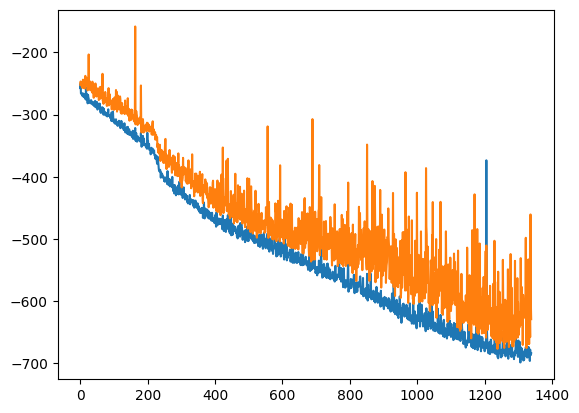

train_weighted_vae: enc
train: iter 0  trainloss -686.42683  validloss -634.00384±0.00000  bestvalidloss -634.00384  last_update 0
train: iter 1  trainloss -686.87215  validloss -620.84589±0.00000  bestvalidloss -634.00384  last_update 1
train: iter 2  trainloss -685.99374  validloss -556.22210±0.00000  bestvalidloss -634.00384  last_update 2
train: iter 3  trainloss -681.94319  validloss -640.24697±0.00000  bestvalidloss -640.24697  last_update 0
train: iter 4  trainloss -692.68062  validloss -620.82366±0.00000  bestvalidloss -640.24697  last_update 1
train: iter 5  trainloss -690.83195  validloss -598.05453±0.00000  bestvalidloss -640.24697  last_update 2
train: iter 6  trainloss -686.80955  validloss -620.69744±0.00000  bestvalidloss -640.24697  last_update 3
train: iter 7  trainloss -692.56216  validloss -640.62340±0.00000  bestvalidloss -640.62340  last_update 0
train: iter 8  trainloss -690.67391  validloss -651.11335±0.00000  bestvalidloss -651.11335  last_update 0
train: iter 9

train: iter 76  trainloss -688.72473  validloss -629.39314±0.00000  bestvalidloss -670.66633  last_update 39
train: iter 77  trainloss -699.05045  validloss -612.63770±0.00000  bestvalidloss -670.66633  last_update 40
train: iter 78  trainloss -696.08125  validloss -608.73272±0.00000  bestvalidloss -670.66633  last_update 41
train: iter 79  trainloss -694.79786  validloss -560.06330±0.00000  bestvalidloss -670.66633  last_update 42
train: iter 80  trainloss -690.89866  validloss -639.76977±0.00000  bestvalidloss -670.66633  last_update 43
train: iter 81  trainloss -689.68791  validloss -604.88489±0.00000  bestvalidloss -670.66633  last_update 44
train: iter 82  trainloss -692.28478  validloss -665.80562±0.00000  bestvalidloss -670.66633  last_update 45
train: iter 83  trainloss -694.45994  validloss -655.49060±0.00000  bestvalidloss -670.66633  last_update 46
train: iter 84  trainloss -693.48306  validloss -633.33712±0.00000  bestvalidloss -670.66633  last_update 47
train: iter 85  tra

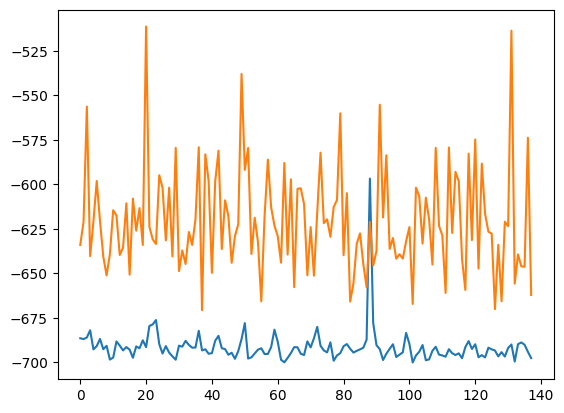

train_weighted_vae: dec
train: iter 0  trainloss -681.68453  validloss -671.72918±0.00000  bestvalidloss -671.72918  last_update 0
train: iter 1  trainloss -690.16986  validloss -583.09528±0.00000  bestvalidloss -671.72918  last_update 1
train: iter 2  trainloss -690.15146  validloss -646.60297±0.00000  bestvalidloss -671.72918  last_update 2
train: iter 3  trainloss -694.40122  validloss -587.23154±0.00000  bestvalidloss -671.72918  last_update 3
train: iter 4  trainloss -697.05201  validloss -598.72879±0.00000  bestvalidloss -671.72918  last_update 4
train: iter 5  trainloss -691.38668  validloss -599.10950±0.00000  bestvalidloss -671.72918  last_update 5
train: iter 6  trainloss -691.13652  validloss -653.31684±0.00000  bestvalidloss -671.72918  last_update 6
train: iter 7  trainloss -695.99945  validloss -629.67756±0.00000  bestvalidloss -671.72918  last_update 7
train: iter 8  trainloss -696.82073  validloss -605.61595±0.00000  bestvalidloss -671.72918  last_update 8
train: iter 9

train: iter 76  trainloss -694.48702  validloss -629.35248±0.00000  bestvalidloss -671.72918  last_update 76
train: iter 77  trainloss -699.77278  validloss -616.16823±0.00000  bestvalidloss -671.72918  last_update 77
train: iter 78  trainloss -692.82585  validloss -619.74408±0.00000  bestvalidloss -671.72918  last_update 78
train: iter 79  trainloss -697.88952  validloss -628.18148±0.00000  bestvalidloss -671.72918  last_update 79
train: iter 80  trainloss -687.87297  validloss -623.87191±0.00000  bestvalidloss -671.72918  last_update 80
train: iter 81  trainloss -692.13166  validloss -615.36282±0.00000  bestvalidloss -671.72918  last_update 81
train: iter 82  trainloss -701.99461  validloss -616.56090±0.00000  bestvalidloss -671.72918  last_update 82
train: iter 83  trainloss -702.61199  validloss -606.18210±0.00000  bestvalidloss -671.72918  last_update 83
train: iter 84  trainloss -700.53228  validloss -627.56379±0.00000  bestvalidloss -671.72918  last_update 84
train: iter 85  tra

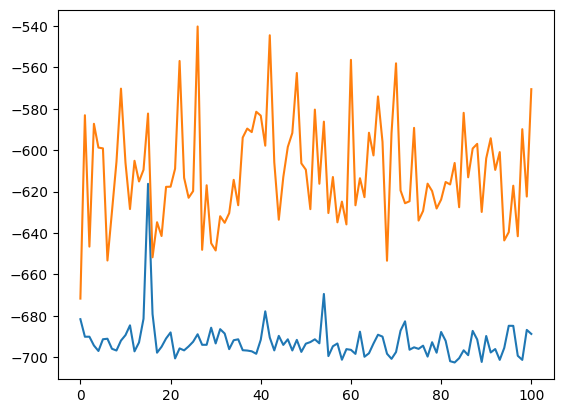

alpha 0.2 vae_lr 0.0005


In [17]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

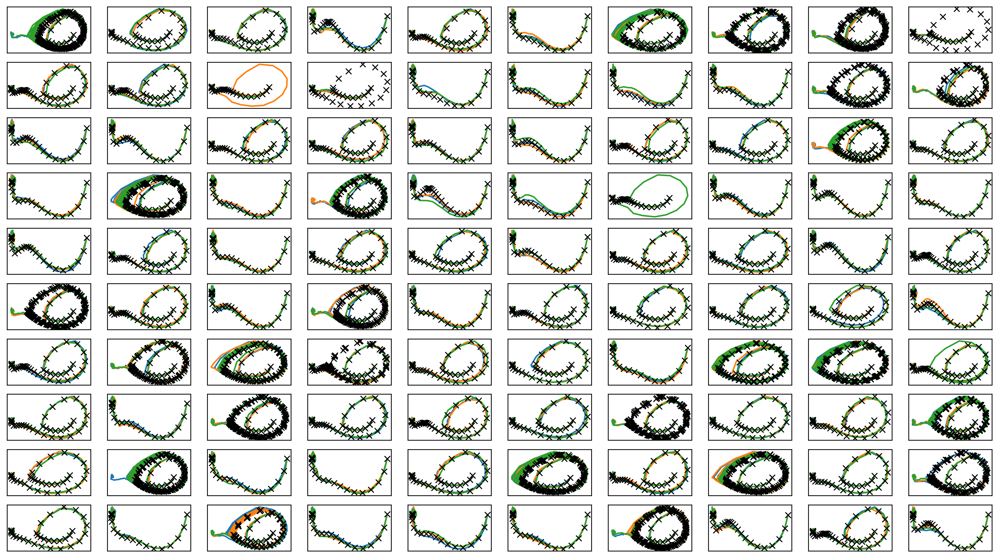

In [18]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter1.png")
plt.savefig(figfilenamehead+"joint_iter1.eps")
plt.savefig(figfilenamehead+"joint_iter1.pdf")
print("実環境方策rollout vs Sim環境方策rollout")

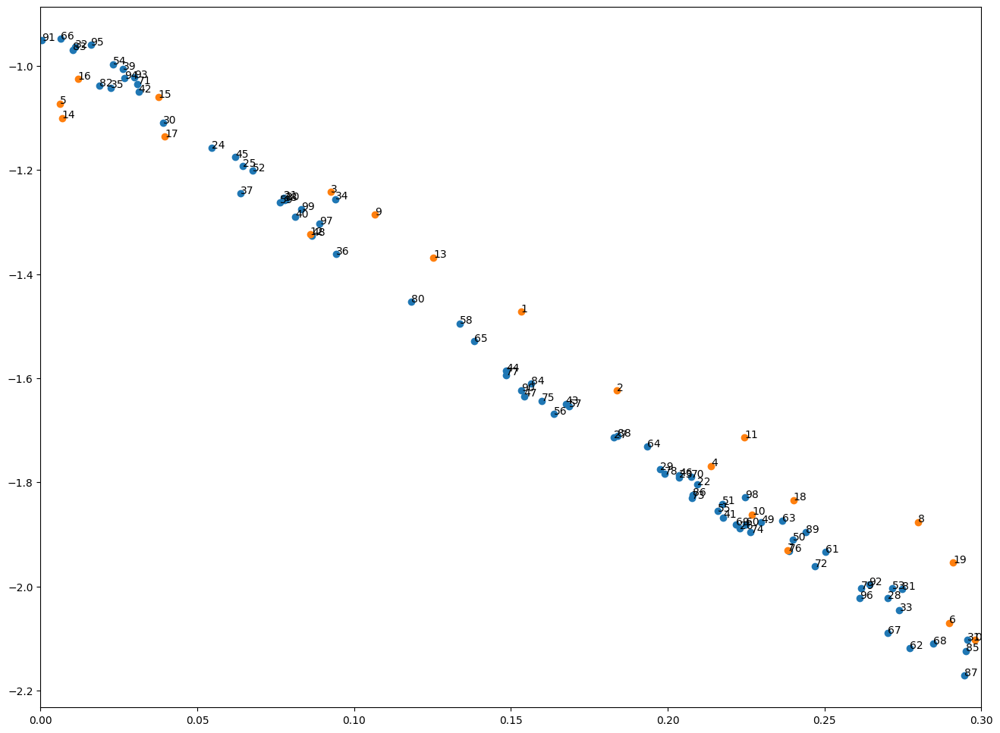

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [19]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter1.png")
plt.savefig(figfilenamehead+"damping_latent_iter1.eps")
plt.savefig(figfilenamehead+"damping_latent_iter1.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [20]:
print(datetime.datetime.now())

2023-03-28 05:57:53.519151


# Iter2

In [21]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [22]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.25879  validloss 0.38651±0.00000  bestvalidloss 0.38651  last_update 0
train: iter 1  trainloss 0.23435  validloss 0.26684±0.00000  bestvalidloss 0.26684  last_update 0
train: iter 2  trainloss 0.21809  validloss 0.25004±0.00000  bestvalidloss 0.25004  last_update 0
train: iter 3  trainloss 0.20972  validloss 0.23620±0.00000  bestvalidloss 0.23620  last_update 0
train: iter 4  trainloss 0.20098  validloss 0.22764±0.00000  bestvalidloss 0.22764  last_update 0
train: iter 5  trainloss 0.19660  validloss 0.22672±0.00000  bestvalidloss 0.22672  last_update 0
train: iter 6  trainloss 0.19189  validloss 0.21953±0.00000  bestvalidloss 0.21953  last_update 0
train: iter 7  trainloss 0.18973  validloss 0.21984±0.00000  bestvalidloss 0.21953  last_update 1
train: iter 8  trainloss 0.18762  validloss 0.22087±0.00000  bestvalidloss 0.21953  last_update 2
train: iter 9  trainloss 0.18332  validloss 0.21313±0.00000  bestvalidloss 0.21313  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.15363  validloss 0.18646±0.00000  bestvalidloss 0.18252  last_update 6
train: iter 85  trainloss 0.15379  validloss 0.18317±0.00000  bestvalidloss 0.18252  last_update 7
train: iter 86  trainloss 0.15469  validloss 0.18714±0.00000  bestvalidloss 0.18252  last_update 8
train: iter 87  trainloss 0.15423  validloss 0.18426±0.00000  bestvalidloss 0.18252  last_update 9
train: iter 88  trainloss 0.15413  validloss 0.18480±0.00000  bestvalidloss 0.18252  last_update 10
train: iter 89  trainloss 0.15255  validloss 0.18770±0.00000  bestvalidloss 0.18252  last_update 11
train: iter 90  trainloss 0.15523  validloss 0.18266±0.00000  bestvalidloss 0.18252  last_update 12
train: iter 91  trainloss 0.15216  validloss 0.18273±0.00000  bestvalidloss 0.18252  last_update 13
train: iter 92  trainloss 0.15189  validloss 0.18248±0.00000  bestvalidloss 0.18248  last_update 0
train: iter 93  trainloss 0.15235  validloss 0.18492±0.00000  bestvalidloss 0.18248  last_update 1
train:

train: iter 168  trainloss 0.14977  validloss 0.17878±0.00000  bestvalidloss 0.17868  last_update 31
train: iter 169  trainloss 0.14778  validloss 0.17874±0.00000  bestvalidloss 0.17868  last_update 32
train: iter 170  trainloss 0.15003  validloss 0.18302±0.00000  bestvalidloss 0.17868  last_update 33
train: iter 171  trainloss 0.14815  validloss 0.18224±0.00000  bestvalidloss 0.17868  last_update 34
train: iter 172  trainloss 0.14788  validloss 0.18217±0.00000  bestvalidloss 0.17868  last_update 35
train: iter 173  trainloss 0.14790  validloss 0.18376±0.00000  bestvalidloss 0.17868  last_update 36
train: iter 174  trainloss 0.14746  validloss 0.17959±0.00000  bestvalidloss 0.17868  last_update 37
train: iter 175  trainloss 0.14738  validloss 0.17759±0.00000  bestvalidloss 0.17759  last_update 0
train: iter 176  trainloss 0.14819  validloss 0.18116±0.00000  bestvalidloss 0.17759  last_update 1
train: iter 177  trainloss 0.14824  validloss 0.17827±0.00000  bestvalidloss 0.17759  last_up

train: iter 250  trainloss 0.14462  validloss 0.18137±0.00000  bestvalidloss 0.17521  last_update 34
train: iter 251  trainloss 0.14329  validloss 0.17490±0.00000  bestvalidloss 0.17490  last_update 0
train: iter 252  trainloss 0.14427  validloss 0.17567±0.00000  bestvalidloss 0.17490  last_update 1
train: iter 253  trainloss 0.14635  validloss 0.17448±0.00000  bestvalidloss 0.17448  last_update 0
train: iter 254  trainloss 0.14438  validloss 0.17562±0.00000  bestvalidloss 0.17448  last_update 1
train: iter 255  trainloss 0.14344  validloss 0.17953±0.00000  bestvalidloss 0.17448  last_update 2
train: iter 256  trainloss 0.14493  validloss 0.17425±0.00000  bestvalidloss 0.17425  last_update 0
train: iter 257  trainloss 0.14324  validloss 0.17402±0.00000  bestvalidloss 0.17402  last_update 0
train: iter 258  trainloss 0.14511  validloss 0.19305±0.00000  bestvalidloss 0.17402  last_update 1
train: iter 259  trainloss 0.14382  validloss 0.17594±0.00000  bestvalidloss 0.17402  last_update 2

train: iter 332  trainloss 0.14191  validloss 0.17209±0.00000  bestvalidloss 0.17061  last_update 6
train: iter 333  trainloss 0.14216  validloss 0.17483±0.00000  bestvalidloss 0.17061  last_update 7
train: iter 334  trainloss 0.14068  validloss 0.17423±0.00000  bestvalidloss 0.17061  last_update 8
train: iter 335  trainloss 0.14183  validloss 0.17383±0.00000  bestvalidloss 0.17061  last_update 9
train: iter 336  trainloss 0.14371  validloss 0.17271±0.00000  bestvalidloss 0.17061  last_update 10
train: iter 337  trainloss 0.14049  validloss 0.17133±0.00000  bestvalidloss 0.17061  last_update 11
train: iter 338  trainloss 0.14053  validloss 0.17273±0.00000  bestvalidloss 0.17061  last_update 12
train: iter 339  trainloss 0.14134  validloss 0.17350±0.00000  bestvalidloss 0.17061  last_update 13
train: iter 340  trainloss 0.14107  validloss 0.17317±0.00000  bestvalidloss 0.17061  last_update 14
train: iter 341  trainloss 0.14207  validloss 0.17199±0.00000  bestvalidloss 0.17061  last_upda

train: iter 415  trainloss 0.13856  validloss 0.16968±0.00000  bestvalidloss 0.16924  last_update 13
train: iter 416  trainloss 0.14077  validloss 0.17822±0.00000  bestvalidloss 0.16924  last_update 14
train: iter 417  trainloss 0.13976  validloss 0.16965±0.00000  bestvalidloss 0.16924  last_update 15
train: iter 418  trainloss 0.13934  validloss 0.17699±0.00000  bestvalidloss 0.16924  last_update 16
train: iter 419  trainloss 0.13935  validloss 0.16950±0.00000  bestvalidloss 0.16924  last_update 17
train: iter 420  trainloss 0.13953  validloss 0.17124±0.00000  bestvalidloss 0.16924  last_update 18
train: iter 421  trainloss 0.13979  validloss 0.16962±0.00000  bestvalidloss 0.16924  last_update 19
train: iter 422  trainloss 0.13882  validloss 0.17202±0.00000  bestvalidloss 0.16924  last_update 20
train: iter 423  trainloss 0.14070  validloss 0.17442±0.00000  bestvalidloss 0.16924  last_update 21
train: iter 424  trainloss 0.13955  validloss 0.16838±0.00000  bestvalidloss 0.16838  last_

train: iter 497  trainloss 0.13657  validloss 0.16924±0.00000  bestvalidloss 0.16764  last_update 40
train: iter 498  trainloss 0.13751  validloss 0.17322±0.00000  bestvalidloss 0.16764  last_update 41
train: iter 499  trainloss 0.13762  validloss 0.17064±0.00000  bestvalidloss 0.16764  last_update 42
train: iter 500  trainloss 0.13808  validloss 0.17055±0.00000  bestvalidloss 0.16764  last_update 43
train: iter 501  trainloss 0.13830  validloss 0.17034±0.00000  bestvalidloss 0.16764  last_update 44
train: iter 502  trainloss 0.13851  validloss 0.17071±0.00000  bestvalidloss 0.16764  last_update 45
train: iter 503  trainloss 0.13902  validloss 0.16786±0.00000  bestvalidloss 0.16764  last_update 46
train: iter 504  trainloss 0.13733  validloss 0.18050±0.00000  bestvalidloss 0.16764  last_update 47
train: iter 505  trainloss 0.13931  validloss 0.17802±0.00000  bestvalidloss 0.16764  last_update 48
train: iter 506  trainloss 0.13781  validloss 0.16866±0.00000  bestvalidloss 0.16764  last_

train: iter 579  trainloss 0.13578  validloss 0.16800±0.00000  bestvalidloss 0.16589  last_update 23
train: iter 580  trainloss 0.13815  validloss 0.16775±0.00000  bestvalidloss 0.16589  last_update 24
train: iter 581  trainloss 0.13711  validloss 0.17113±0.00000  bestvalidloss 0.16589  last_update 25
train: iter 582  trainloss 0.13601  validloss 0.16990±0.00000  bestvalidloss 0.16589  last_update 26
train: iter 583  trainloss 0.13654  validloss 0.16858±0.00000  bestvalidloss 0.16589  last_update 27
train: iter 584  trainloss 0.13616  validloss 0.16840±0.00000  bestvalidloss 0.16589  last_update 28
train: iter 585  trainloss 0.13599  validloss 0.16744±0.00000  bestvalidloss 0.16589  last_update 29
train: iter 586  trainloss 0.13622  validloss 0.16632±0.00000  bestvalidloss 0.16589  last_update 30
train: iter 587  trainloss 0.13601  validloss 0.17046±0.00000  bestvalidloss 0.16589  last_update 31
train: iter 588  trainloss 0.13618  validloss 0.16681±0.00000  bestvalidloss 0.16589  last_

train: iter 661  trainloss 0.13497  validloss 0.16823±0.00000  bestvalidloss 0.16407  last_update 6
train: iter 662  trainloss 0.13664  validloss 0.16385±0.00000  bestvalidloss 0.16385  last_update 0
train: iter 663  trainloss 0.13429  validloss 0.16769±0.00000  bestvalidloss 0.16385  last_update 1
train: iter 664  trainloss 0.13439  validloss 0.16834±0.00000  bestvalidloss 0.16385  last_update 2
train: iter 665  trainloss 0.13447  validloss 0.17627±0.00000  bestvalidloss 0.16385  last_update 3
train: iter 666  trainloss 0.13629  validloss 0.16602±0.00000  bestvalidloss 0.16385  last_update 4
train: iter 667  trainloss 0.13500  validloss 0.16655±0.00000  bestvalidloss 0.16385  last_update 5
train: iter 668  trainloss 0.13739  validloss 0.16526±0.00000  bestvalidloss 0.16385  last_update 6
train: iter 669  trainloss 0.13752  validloss 0.17059±0.00000  bestvalidloss 0.16385  last_update 7
train: iter 670  trainloss 0.13441  validloss 0.16497±0.00000  bestvalidloss 0.16385  last_update 8


train: iter 743  trainloss 0.13385  validloss 0.16889±0.00000  bestvalidloss 0.16261  last_update 22
train: iter 744  trainloss 0.13395  validloss 0.16675±0.00000  bestvalidloss 0.16261  last_update 23
train: iter 745  trainloss 0.13348  validloss 0.16351±0.00000  bestvalidloss 0.16261  last_update 24
train: iter 746  trainloss 0.13605  validloss 0.16932±0.00000  bestvalidloss 0.16261  last_update 25
train: iter 747  trainloss 0.13420  validloss 0.16380±0.00000  bestvalidloss 0.16261  last_update 26
train: iter 748  trainloss 0.13474  validloss 0.16466±0.00000  bestvalidloss 0.16261  last_update 27
train: iter 749  trainloss 0.13410  validloss 0.16529±0.00000  bestvalidloss 0.16261  last_update 28
train: iter 750  trainloss 0.13331  validloss 0.16184±0.00000  bestvalidloss 0.16184  last_update 0
train: iter 751  trainloss 0.13318  validloss 0.16355±0.00000  bestvalidloss 0.16184  last_update 1
train: iter 752  trainloss 0.13362  validloss 0.16360±0.00000  bestvalidloss 0.16184  last_up

train: iter 825  trainloss 0.13425  validloss 0.17531±0.00000  bestvalidloss 0.16184  last_update 75
train: iter 826  trainloss 0.13240  validloss 0.16295±0.00000  bestvalidloss 0.16184  last_update 76
train: iter 827  trainloss 0.13218  validloss 0.16321±0.00000  bestvalidloss 0.16184  last_update 77
train: iter 828  trainloss 0.13207  validloss 0.16344±0.00000  bestvalidloss 0.16184  last_update 78
train: iter 829  trainloss 0.13228  validloss 0.16500±0.00000  bestvalidloss 0.16184  last_update 79
train: iter 830  trainloss 0.13245  validloss 0.16726±0.00000  bestvalidloss 0.16184  last_update 80
train: iter 831  trainloss 0.13162  validloss 0.16408±0.00000  bestvalidloss 0.16184  last_update 81
train: iter 832  trainloss 0.13302  validloss 0.16236±0.00000  bestvalidloss 0.16184  last_update 82
train: iter 833  trainloss 0.13215  validloss 0.16507±0.00000  bestvalidloss 0.16184  last_update 83
train: iter 834  trainloss 0.13282  validloss 0.16569±0.00000  bestvalidloss 0.16184  last_

train: iter 907  trainloss 0.13152  validloss 0.16727±0.00000  bestvalidloss 0.16024  last_update 31
train: iter 908  trainloss 0.13086  validloss 0.16263±0.00000  bestvalidloss 0.16024  last_update 32
train: iter 909  trainloss 0.13141  validloss 0.16412±0.00000  bestvalidloss 0.16024  last_update 33
train: iter 910  trainloss 0.13121  validloss 0.16515±0.00000  bestvalidloss 0.16024  last_update 34
train: iter 911  trainloss 0.13308  validloss 0.16228±0.00000  bestvalidloss 0.16024  last_update 35
train: iter 912  trainloss 0.13279  validloss 0.16285±0.00000  bestvalidloss 0.16024  last_update 36
train: iter 913  trainloss 0.13205  validloss 0.16541±0.00000  bestvalidloss 0.16024  last_update 37
train: iter 914  trainloss 0.13091  validloss 0.16371±0.00000  bestvalidloss 0.16024  last_update 38
train: iter 915  trainloss 0.13104  validloss 0.16316±0.00000  bestvalidloss 0.16024  last_update 39
train: iter 916  trainloss 0.13104  validloss 0.16085±0.00000  bestvalidloss 0.16024  last_

train: iter 990  trainloss 0.13062  validloss 0.16185±0.00000  bestvalidloss 0.15946  last_update 12
train: iter 991  trainloss 0.13181  validloss 0.16011±0.00000  bestvalidloss 0.15946  last_update 13
train: iter 992  trainloss 0.13180  validloss 0.16278±0.00000  bestvalidloss 0.15946  last_update 14
train: iter 993  trainloss 0.13102  validloss 0.16290±0.00000  bestvalidloss 0.15946  last_update 15
train: iter 994  trainloss 0.13199  validloss 0.16394±0.00000  bestvalidloss 0.15946  last_update 16
train: iter 995  trainloss 0.12981  validloss 0.16023±0.00000  bestvalidloss 0.15946  last_update 17
train: iter 996  trainloss 0.13060  validloss 0.15930±0.00000  bestvalidloss 0.15930  last_update 0
train: iter 997  trainloss 0.13153  validloss 0.16331±0.00000  bestvalidloss 0.15930  last_update 1
train: iter 998  trainloss 0.12988  validloss 0.16303±0.00000  bestvalidloss 0.15930  last_update 2
train: iter 999  trainloss 0.13074  validloss 0.16080±0.00000  bestvalidloss 0.15930  last_upd

train: iter 1072  trainloss 0.12981  validloss 0.15879±0.00000  bestvalidloss 0.15879  last_update 0
train: iter 1073  trainloss 0.13246  validloss 0.15867±0.00000  bestvalidloss 0.15867  last_update 0
train: iter 1074  trainloss 0.13081  validloss 0.16825±0.00000  bestvalidloss 0.15867  last_update 1
train: iter 1075  trainloss 0.12981  validloss 0.15962±0.00000  bestvalidloss 0.15867  last_update 2
train: iter 1076  trainloss 0.12897  validloss 0.15915±0.00000  bestvalidloss 0.15867  last_update 3
train: iter 1077  trainloss 0.12918  validloss 0.16021±0.00000  bestvalidloss 0.15867  last_update 4
train: iter 1078  trainloss 0.12887  validloss 0.16271±0.00000  bestvalidloss 0.15867  last_update 5
train: iter 1079  trainloss 0.12875  validloss 0.16576±0.00000  bestvalidloss 0.15867  last_update 6
train: iter 1080  trainloss 0.13452  validloss 0.16190±0.00000  bestvalidloss 0.15867  last_update 7
train: iter 1081  trainloss 0.12946  validloss 0.16069±0.00000  bestvalidloss 0.15867  last

train: iter 1154  trainloss 0.12993  validloss 0.16258±0.00000  bestvalidloss 0.15768  last_update 4
train: iter 1155  trainloss 0.12801  validloss 0.15933±0.00000  bestvalidloss 0.15768  last_update 5
train: iter 1156  trainloss 0.12860  validloss 0.15925±0.00000  bestvalidloss 0.15768  last_update 6
train: iter 1157  trainloss 0.12943  validloss 0.16143±0.00000  bestvalidloss 0.15768  last_update 7
train: iter 1158  trainloss 0.12921  validloss 0.15946±0.00000  bestvalidloss 0.15768  last_update 8
train: iter 1159  trainloss 0.12911  validloss 0.16046±0.00000  bestvalidloss 0.15768  last_update 9
train: iter 1160  trainloss 0.12795  validloss 0.15926±0.00000  bestvalidloss 0.15768  last_update 10
train: iter 1161  trainloss 0.12805  validloss 0.15886±0.00000  bestvalidloss 0.15768  last_update 11
train: iter 1162  trainloss 0.13016  validloss 0.15828±0.00000  bestvalidloss 0.15768  last_update 12
train: iter 1163  trainloss 0.12862  validloss 0.15911±0.00000  bestvalidloss 0.15768  l

train: iter 1237  trainloss 0.12781  validloss 0.15948±0.00000  bestvalidloss 0.15757  last_update 43
train: iter 1238  trainloss 0.12911  validloss 0.15950±0.00000  bestvalidloss 0.15757  last_update 44
train: iter 1239  trainloss 0.12729  validloss 0.15819±0.00000  bestvalidloss 0.15757  last_update 45
train: iter 1240  trainloss 0.12658  validloss 0.16272±0.00000  bestvalidloss 0.15757  last_update 46
train: iter 1241  trainloss 0.12682  validloss 0.16591±0.00000  bestvalidloss 0.15757  last_update 47
train: iter 1242  trainloss 0.12872  validloss 0.15893±0.00000  bestvalidloss 0.15757  last_update 48
train: iter 1243  trainloss 0.12783  validloss 0.16564±0.00000  bestvalidloss 0.15757  last_update 49
train: iter 1244  trainloss 0.12849  validloss 0.15698±0.00000  bestvalidloss 0.15698  last_update 0
train: iter 1245  trainloss 0.12903  validloss 0.15763±0.00000  bestvalidloss 0.15698  last_update 1
train: iter 1246  trainloss 0.12801  validloss 0.16020±0.00000  bestvalidloss 0.1569

train: iter 1319  trainloss 0.12700  validloss 0.15731±0.00000  bestvalidloss 0.15687  last_update 6
train: iter 1320  trainloss 0.12703  validloss 0.15770±0.00000  bestvalidloss 0.15687  last_update 7
train: iter 1321  trainloss 0.12786  validloss 0.16344±0.00000  bestvalidloss 0.15687  last_update 8
train: iter 1322  trainloss 0.12633  validloss 0.16059±0.00000  bestvalidloss 0.15687  last_update 9
train: iter 1323  trainloss 0.12735  validloss 0.15794±0.00000  bestvalidloss 0.15687  last_update 10
train: iter 1324  trainloss 0.12776  validloss 0.15730±0.00000  bestvalidloss 0.15687  last_update 11
train: iter 1325  trainloss 0.12607  validloss 0.16475±0.00000  bestvalidloss 0.15687  last_update 12
train: iter 1326  trainloss 0.12680  validloss 0.15834±0.00000  bestvalidloss 0.15687  last_update 13
train: iter 1327  trainloss 0.12648  validloss 0.16011±0.00000  bestvalidloss 0.15687  last_update 14
train: iter 1328  trainloss 0.12734  validloss 0.15979±0.00000  bestvalidloss 0.15687 

train: iter 1400  trainloss 0.12606  validloss 0.16077±0.00000  bestvalidloss 0.15551  last_update 44
train: iter 1401  trainloss 0.12615  validloss 0.15998±0.00000  bestvalidloss 0.15551  last_update 45
train: iter 1402  trainloss 0.12687  validloss 0.15715±0.00000  bestvalidloss 0.15551  last_update 46
train: iter 1403  trainloss 0.12561  validloss 0.15904±0.00000  bestvalidloss 0.15551  last_update 47
train: iter 1404  trainloss 0.12839  validloss 0.15698±0.00000  bestvalidloss 0.15551  last_update 48
train: iter 1405  trainloss 0.12687  validloss 0.15844±0.00000  bestvalidloss 0.15551  last_update 49
train: iter 1406  trainloss 0.12594  validloss 0.15652±0.00000  bestvalidloss 0.15551  last_update 50
train: iter 1407  trainloss 0.12544  validloss 0.16161±0.00000  bestvalidloss 0.15551  last_update 51
train: iter 1408  trainloss 0.12703  validloss 0.15834±0.00000  bestvalidloss 0.15551  last_update 52
train: iter 1409  trainloss 0.12597  validloss 0.15790±0.00000  bestvalidloss 0.15

In [23]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -182.51066341400147
valid_loss:  -199.5255257177353
train_loss:  -262.79590102672574
valid_loss:  -220.40337195158003


1e-08 1000.0


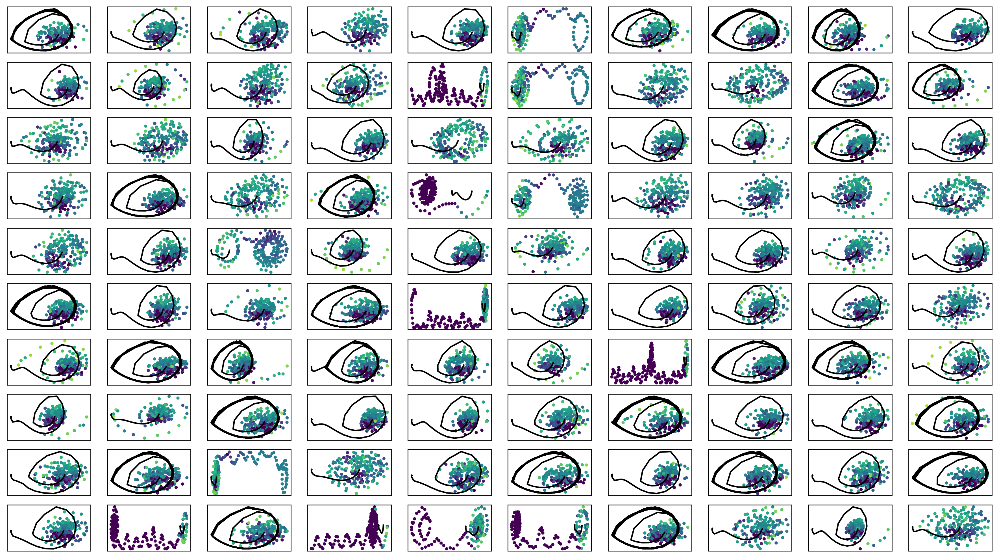

In [24]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter2.png")

In [25]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [26]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -252.85234  validloss -226.20606±0.00000  bestvalidloss -226.20606  last_update 0
train: iter 1  trainloss -261.70061  validloss -209.62352±0.00000  bestvalidloss -226.20606  last_update 1
train: iter 2  trainloss -254.75357  validloss -220.20306±0.00000  bestvalidloss -226.20606  last_update 2
train: iter 3  trainloss -254.39418  validloss -218.75994±0.00000  bestvalidloss -226.20606  last_update 3
train: iter 4  trainloss -253.86928  validloss -242.85138±0.00000  bestvalidloss -242.85138  last_update 0
train: iter 5  trainloss -255.54743  validloss -240.59835±0.00000  bestvalidloss -242.85138  last_update 1
train: iter 6  trainloss -254.33556  validloss -215.52290±0.00000  bestvalidloss -242.85138  last_update 2
train: iter 7  trainloss -257.71157  validloss -223.56966±0.00000  bestvalidloss -242.85138  last_update 3
train: iter 8  trainloss -247.12212  validloss -218.08365±0.00000  bestvalidloss -242.85138  last_update 4
train: it

train: iter 76  trainloss -245.00581  validloss -235.16732±0.00000  bestvalidloss -256.43296  last_update 55
train: iter 77  trainloss -255.62067  validloss -232.16983±0.00000  bestvalidloss -256.43296  last_update 56
train: iter 78  trainloss -254.44119  validloss -196.58938±0.00000  bestvalidloss -256.43296  last_update 57
train: iter 79  trainloss -260.18880  validloss -217.55889±0.00000  bestvalidloss -256.43296  last_update 58
train: iter 80  trainloss -253.36496  validloss -226.25370±0.00000  bestvalidloss -256.43296  last_update 59
train: iter 81  trainloss -256.72060  validloss -213.90138±0.00000  bestvalidloss -256.43296  last_update 60
train: iter 82  trainloss -259.04963  validloss -256.08168±0.00000  bestvalidloss -256.43296  last_update 61
train: iter 83  trainloss -250.68553  validloss -231.92059±0.00000  bestvalidloss -256.43296  last_update 62
train: iter 84  trainloss -258.72097  validloss -217.58396±0.00000  bestvalidloss -256.43296  last_update 63
train: iter 85  tra

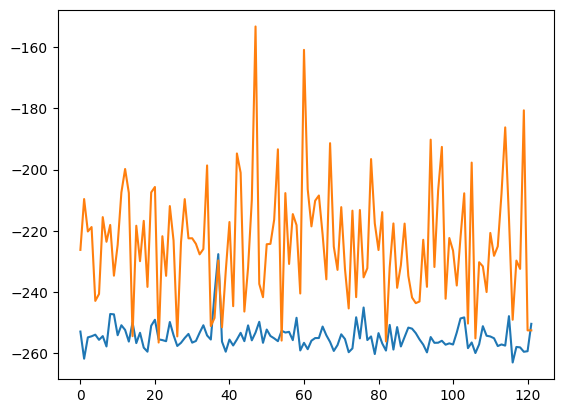

train_weighted_vae: enc
train: iter 0  trainloss -247.07320  validloss -200.59894±0.00000  bestvalidloss -200.59894  last_update 0
train: iter 1  trainloss -252.99420  validloss -241.18582±0.00000  bestvalidloss -241.18582  last_update 0
train: iter 2  trainloss -252.94158  validloss -211.00880±0.00000  bestvalidloss -241.18582  last_update 1
train: iter 3  trainloss -246.65693  validloss -237.80884±0.00000  bestvalidloss -241.18582  last_update 2
train: iter 4  trainloss -254.42503  validloss -231.71055±0.00000  bestvalidloss -241.18582  last_update 3
train: iter 5  trainloss -256.28895  validloss -227.21046±0.00000  bestvalidloss -241.18582  last_update 4
train: iter 6  trainloss -251.93036  validloss -236.80550±0.00000  bestvalidloss -241.18582  last_update 5
train: iter 7  trainloss -254.35500  validloss -217.92558±0.00000  bestvalidloss -241.18582  last_update 6
train: iter 8  trainloss -254.28778  validloss -238.80569±0.00000  bestvalidloss -241.18582  last_update 7
train: iter 9

train: iter 77  trainloss -244.68091  validloss -185.75224±0.00000  bestvalidloss -252.80261  last_update 35
train: iter 78  trainloss -253.07423  validloss -236.18779±0.00000  bestvalidloss -252.80261  last_update 36
train: iter 79  trainloss -251.11340  validloss -201.73780±0.00000  bestvalidloss -252.80261  last_update 37
train: iter 80  trainloss -249.03657  validloss -235.84274±0.00000  bestvalidloss -252.80261  last_update 38
train: iter 81  trainloss -252.14944  validloss -240.14676±0.00000  bestvalidloss -252.80261  last_update 39
train: iter 82  trainloss -253.65981  validloss -229.19270±0.00000  bestvalidloss -252.80261  last_update 40
train: iter 83  trainloss -251.82030  validloss -218.85924±0.00000  bestvalidloss -252.80261  last_update 41
train: iter 84  trainloss -253.35076  validloss -227.09012±0.00000  bestvalidloss -252.80261  last_update 42
train: iter 85  trainloss -251.03837  validloss -221.13115±0.00000  bestvalidloss -252.80261  last_update 43
train: iter 86  tra

train: iter 152  trainloss -232.30659  validloss -198.86233±0.00000  bestvalidloss -252.83259  last_update 37
train: iter 153  trainloss -237.69125  validloss -186.87137±0.00000  bestvalidloss -252.83259  last_update 38
train: iter 154  trainloss -242.00101  validloss -219.79054±0.00000  bestvalidloss -252.83259  last_update 39
train: iter 155  trainloss -248.44340  validloss -224.29897±0.00000  bestvalidloss -252.83259  last_update 40
train: iter 156  trainloss -249.47358  validloss -212.70074±0.00000  bestvalidloss -252.83259  last_update 41
train: iter 157  trainloss -245.06025  validloss -190.41265±0.00000  bestvalidloss -252.83259  last_update 42
train: iter 158  trainloss -245.53458  validloss -199.17714±0.00000  bestvalidloss -252.83259  last_update 43
train: iter 159  trainloss -249.06047  validloss -231.19468±0.00000  bestvalidloss -252.83259  last_update 44
train: iter 160  trainloss -249.33088  validloss -233.67672±0.00000  bestvalidloss -252.83259  last_update 45
train: ite

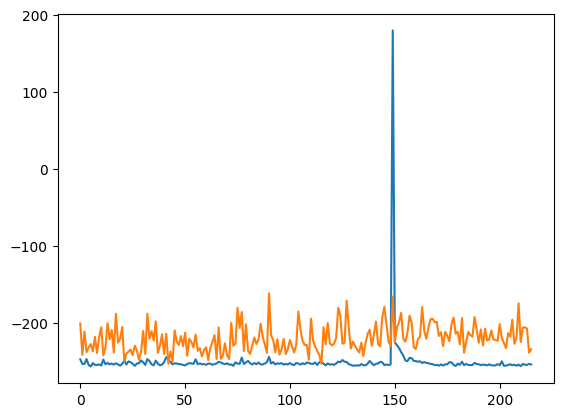

train_weighted_vae: dec
train: iter 0  trainloss -258.96266  validloss -198.37540±0.00000  bestvalidloss -198.37540  last_update 0
train: iter 1  trainloss -259.31825  validloss -208.34529±0.00000  bestvalidloss -208.34529  last_update 0
train: iter 2  trainloss -257.40155  validloss -217.22189±0.00000  bestvalidloss -217.22189  last_update 0
train: iter 3  trainloss -264.22136  validloss -205.69277±0.00000  bestvalidloss -217.22189  last_update 1
train: iter 4  trainloss -259.20954  validloss -194.27489±0.00000  bestvalidloss -217.22189  last_update 2
train: iter 5  trainloss -257.59411  validloss -212.53833±0.00000  bestvalidloss -217.22189  last_update 3
train: iter 6  trainloss -262.21597  validloss -201.37962±0.00000  bestvalidloss -217.22189  last_update 4
train: iter 7  trainloss -261.97029  validloss -182.19062±0.00000  bestvalidloss -217.22189  last_update 5
train: iter 8  trainloss -262.08547  validloss -195.27740±0.00000  bestvalidloss -217.22189  last_update 6
train: iter 9

train: iter 76  trainloss -262.23297  validloss -201.42203±0.00000  bestvalidloss -229.89903  last_update 46
train: iter 77  trainloss -264.11692  validloss -196.26027±0.00000  bestvalidloss -229.89903  last_update 47
train: iter 78  trainloss -261.05930  validloss -211.80601±0.00000  bestvalidloss -229.89903  last_update 48
train: iter 79  trainloss -259.68839  validloss -187.39784±0.00000  bestvalidloss -229.89903  last_update 49
train: iter 80  trainloss -263.29367  validloss -199.86509±0.00000  bestvalidloss -229.89903  last_update 50
train: iter 81  trainloss -261.09718  validloss -205.87122±0.00000  bestvalidloss -229.89903  last_update 51
train: iter 82  trainloss -261.53049  validloss -186.97983±0.00000  bestvalidloss -229.89903  last_update 52
train: iter 83  trainloss -263.37150  validloss -176.16122±0.00000  bestvalidloss -229.89903  last_update 53
train: iter 84  trainloss -266.04598  validloss -195.86168±0.00000  bestvalidloss -229.89903  last_update 54
train: iter 85  tra

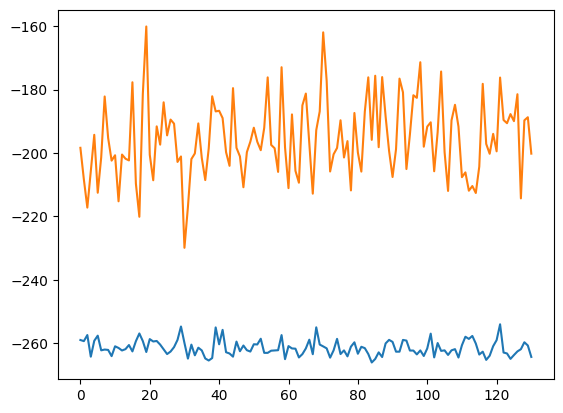

alpha 0.2 vae_lr 0.0005


In [27]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

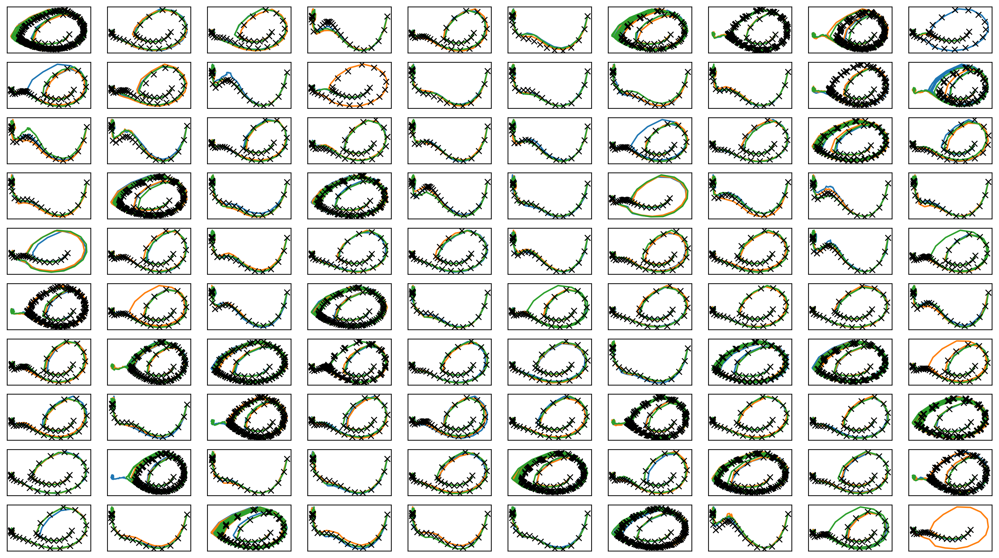

In [28]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter2.png")
plt.savefig(figfilenamehead+"joint_iter2.eps")
plt.savefig(figfilenamehead+"joint_iter2.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

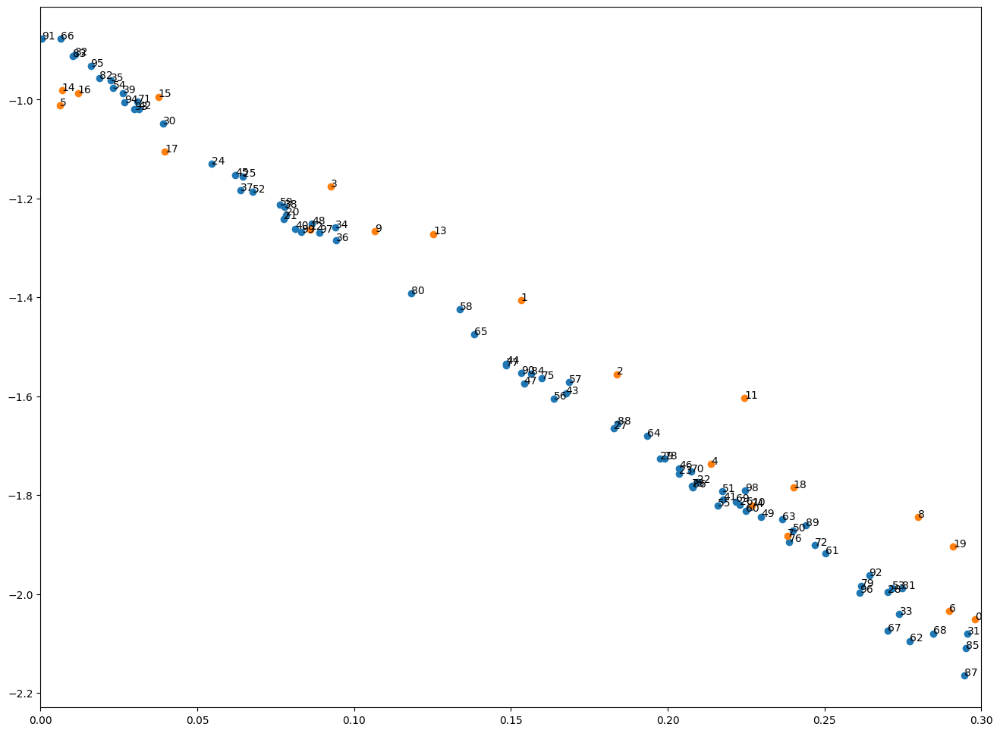

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [29]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter2.png")
plt.savefig(figfilenamehead+"damping_latent_iter2.eps")
plt.savefig(figfilenamehead+"damping_latent_iter2.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [30]:
print(datetime.datetime.now())

2023-03-28 06:03:41.759317


# Iter 3

In [31]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [32]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)



train: iter 0  trainloss 0.14329  validloss 0.15780±0.00000  bestvalidloss 0.15780  last_update 0
train: iter 1  trainloss 0.13959  validloss 0.15634±0.00000  bestvalidloss 0.15634  last_update 0
train: iter 2  trainloss 0.14027  validloss 0.15881±0.00000  bestvalidloss 0.15634  last_update 1
train: iter 3  trainloss 0.13975  validloss 0.15765±0.00000  bestvalidloss 0.15634  last_update 2
train: iter 4  trainloss 0.14042  validloss 0.15595±0.00000  bestvalidloss 0.15595  last_update 0
train: iter 5  trainloss 0.14085  validloss 0.15577±0.00000  bestvalidloss 0.15577  last_update 0
train: iter 6  trainloss 0.13866  validloss 0.15762±0.00000  bestvalidloss 0.15577  last_update 1
train: iter 7  trainloss 0.13903  validloss 0.15885±0.00000  bestvalidloss 0.15577  last_update 2
train: iter 8  trainloss 0.14057  validloss 0.15616±0.00000  bestvalidloss 0.15577  last_update 3
train: iter 9  trainloss 0.13856  validloss 0.16064±0.00000  bestvalidloss 0.15577  last_update 4
train: iter 10  trai

train: iter 84  trainloss 0.13654  validloss 0.15582±0.00000  bestvalidloss 0.15416  last_update 32
train: iter 85  trainloss 0.13576  validloss 0.15563±0.00000  bestvalidloss 0.15416  last_update 33
train: iter 86  trainloss 0.13639  validloss 0.15459±0.00000  bestvalidloss 0.15416  last_update 34
train: iter 87  trainloss 0.13847  validloss 0.15356±0.00000  bestvalidloss 0.15356  last_update 0
train: iter 88  trainloss 0.13640  validloss 0.15609±0.00000  bestvalidloss 0.15356  last_update 1
train: iter 89  trainloss 0.13653  validloss 0.15422±0.00000  bestvalidloss 0.15356  last_update 2
train: iter 90  trainloss 0.13681  validloss 0.16042±0.00000  bestvalidloss 0.15356  last_update 3
train: iter 91  trainloss 0.13629  validloss 0.15530±0.00000  bestvalidloss 0.15356  last_update 4
train: iter 92  trainloss 0.13615  validloss 0.15444±0.00000  bestvalidloss 0.15356  last_update 5
train: iter 93  trainloss 0.13660  validloss 0.15437±0.00000  bestvalidloss 0.15356  last_update 6
train: 

train: iter 168  trainloss 0.13635  validloss 0.15403±0.00000  bestvalidloss 0.15312  last_update 62
train: iter 169  trainloss 0.13550  validloss 0.15724±0.00000  bestvalidloss 0.15312  last_update 63
train: iter 170  trainloss 0.13599  validloss 0.15764±0.00000  bestvalidloss 0.15312  last_update 64
train: iter 171  trainloss 0.13591  validloss 0.15963±0.00000  bestvalidloss 0.15312  last_update 65
train: iter 172  trainloss 0.13509  validloss 0.15343±0.00000  bestvalidloss 0.15312  last_update 66
train: iter 173  trainloss 0.13784  validloss 0.15390±0.00000  bestvalidloss 0.15312  last_update 67
train: iter 174  trainloss 0.13613  validloss 0.15626±0.00000  bestvalidloss 0.15312  last_update 68
train: iter 175  trainloss 0.13560  validloss 0.15830±0.00000  bestvalidloss 0.15312  last_update 69
train: iter 176  trainloss 0.13511  validloss 0.15372±0.00000  bestvalidloss 0.15312  last_update 70
train: iter 177  trainloss 0.13499  validloss 0.15566±0.00000  bestvalidloss 0.15312  last_

In [33]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -166.42224563121798
valid_loss:  -139.48166932582856
train_loss:  -294.4976125669479
valid_loss:  -209.67729247093197


1e-08 1000.0


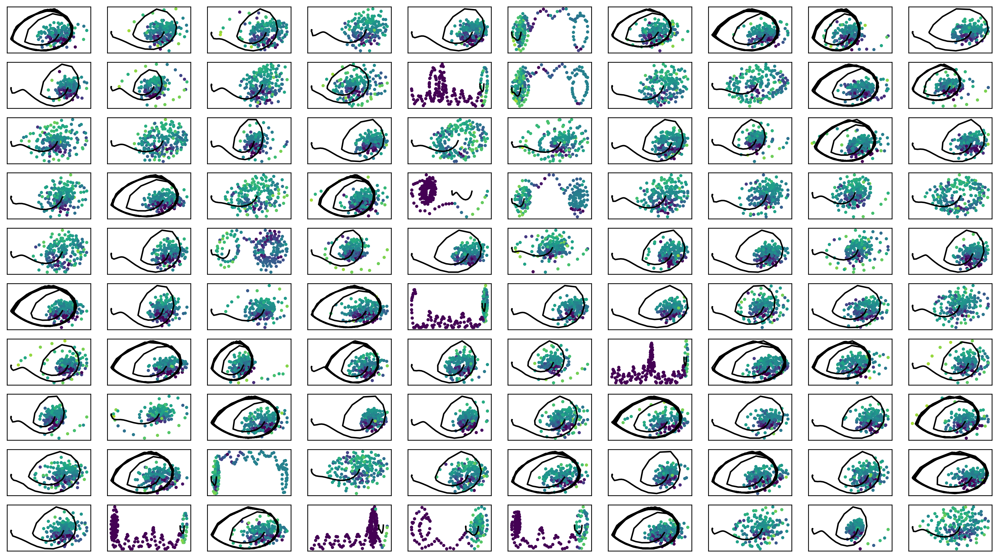

In [34]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter3.png")

In [35]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [36]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [37]:
# i = 49
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -281.29039  validloss -212.13579±0.00000  bestvalidloss -212.13579  last_update 0
train: iter 1  trainloss -291.75526  validloss -274.94846±0.00000  bestvalidloss -274.94846  last_update 0
train: iter 2  trainloss -281.74035  validloss -252.68641±0.00000  bestvalidloss -274.94846  last_update 1
train: iter 3  trainloss -286.34807  validloss -213.57991±0.00000  bestvalidloss -274.94846  last_update 2
train: iter 4  trainloss -287.98803  validloss -235.82922±0.00000  bestvalidloss -274.94846  last_update 3
train: iter 5  trainloss -291.44750  validloss -208.49500±0.00000  bestvalidloss -274.94846  last_update 4
train: iter 6  trainloss -287.26771  validloss -232.96245±0.00000  bestvalidloss -274.94846  last_update 5
train: iter 7  trainloss -285.11979  validloss -267.86289±0.00000  bestvalidloss -274.94846  last_update 6
train: iter 8  trainloss -292.28189  validloss -235.66394±0.00000  bestvalidloss -274.94846  last_update 7
train: it

train: iter 76  trainloss -294.52924  validloss -258.67068±0.00000  bestvalidloss -290.98462  last_update 2
train: iter 77  trainloss -292.42709  validloss -252.81697±0.00000  bestvalidloss -290.98462  last_update 3
train: iter 78  trainloss -290.47349  validloss -271.44703±0.00000  bestvalidloss -290.98462  last_update 4
train: iter 79  trainloss -286.87536  validloss -151.09890±0.00000  bestvalidloss -290.98462  last_update 5
train: iter 80  trainloss -283.48371  validloss -259.59463±0.00000  bestvalidloss -290.98462  last_update 6
train: iter 81  trainloss -293.29997  validloss -267.07101±0.00000  bestvalidloss -290.98462  last_update 7
train: iter 82  trainloss -292.18657  validloss -251.20948±0.00000  bestvalidloss -290.98462  last_update 8
train: iter 83  trainloss -288.92384  validloss -243.24787±0.00000  bestvalidloss -290.98462  last_update 9
train: iter 84  trainloss -292.07683  validloss -249.62407±0.00000  bestvalidloss -290.98462  last_update 10
train: iter 85  trainloss -

train: iter 151  trainloss -284.70876  validloss -260.79796±0.00000  bestvalidloss -290.98462  last_update 77
train: iter 152  trainloss -293.39443  validloss -253.50296±0.00000  bestvalidloss -290.98462  last_update 78
train: iter 153  trainloss -295.14489  validloss -264.47185±0.00000  bestvalidloss -290.98462  last_update 79
train: iter 154  trainloss -286.81398  validloss -246.80180±0.00000  bestvalidloss -290.98462  last_update 80
train: iter 155  trainloss -287.19959  validloss -226.09385±0.00000  bestvalidloss -290.98462  last_update 81
train: iter 156  trainloss -292.45797  validloss -262.19357±0.00000  bestvalidloss -290.98462  last_update 82
train: iter 157  trainloss -291.02016  validloss -249.66918±0.00000  bestvalidloss -290.98462  last_update 83
train: iter 158  trainloss -290.19516  validloss -266.53622±0.00000  bestvalidloss -290.98462  last_update 84
train: iter 159  trainloss -295.94611  validloss -248.41799±0.00000  bestvalidloss -290.98462  last_update 85
train: ite

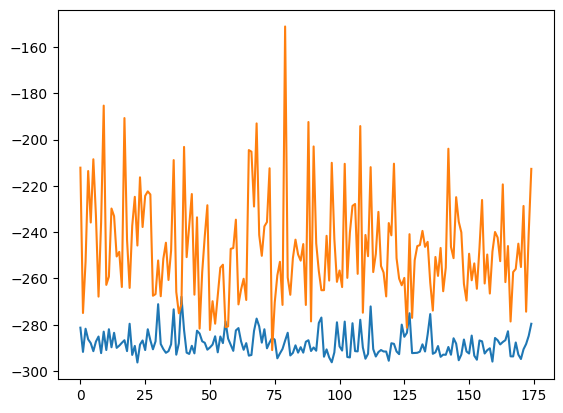

train_weighted_vae: enc
train: iter 0  trainloss -286.59271  validloss -274.09060±0.00000  bestvalidloss -274.09060  last_update 0
train: iter 1  trainloss -292.51636  validloss -272.61926±0.00000  bestvalidloss -274.09060  last_update 1
train: iter 2  trainloss -293.23945  validloss -295.22894±0.00000  bestvalidloss -295.22894  last_update 0
train: iter 3  trainloss -293.31321  validloss -273.42035±0.00000  bestvalidloss -295.22894  last_update 1
train: iter 4  trainloss -293.11632  validloss -281.66416±0.00000  bestvalidloss -295.22894  last_update 2
train: iter 5  trainloss -292.67099  validloss -261.72082±0.00000  bestvalidloss -295.22894  last_update 3
train: iter 6  trainloss -294.58353  validloss -264.86163±0.00000  bestvalidloss -295.22894  last_update 4
train: iter 7  trainloss -292.32796  validloss -277.95708±0.00000  bestvalidloss -295.22894  last_update 5
train: iter 8  trainloss -293.17383  validloss -242.63487±0.00000  bestvalidloss -295.22894  last_update 6
train: iter 9

train: iter 77  trainloss -293.55014  validloss -258.37670±0.00000  bestvalidloss -295.22894  last_update 75
train: iter 78  trainloss -294.39859  validloss -264.47754±0.00000  bestvalidloss -295.22894  last_update 76
train: iter 79  trainloss -293.38232  validloss -254.21022±0.00000  bestvalidloss -295.22894  last_update 77
train: iter 80  trainloss -293.19110  validloss -255.79860±0.00000  bestvalidloss -295.22894  last_update 78
train: iter 81  trainloss -294.86280  validloss -253.20342±0.00000  bestvalidloss -295.22894  last_update 79
train: iter 82  trainloss -294.15536  validloss -278.43770±0.00000  bestvalidloss -295.22894  last_update 80
train: iter 83  trainloss -293.58788  validloss -264.88290±0.00000  bestvalidloss -295.22894  last_update 81
train: iter 84  trainloss -294.15043  validloss -273.98479±0.00000  bestvalidloss -295.22894  last_update 82
train: iter 85  trainloss -294.40081  validloss -263.40325±0.00000  bestvalidloss -295.22894  last_update 83
train: iter 86  tra

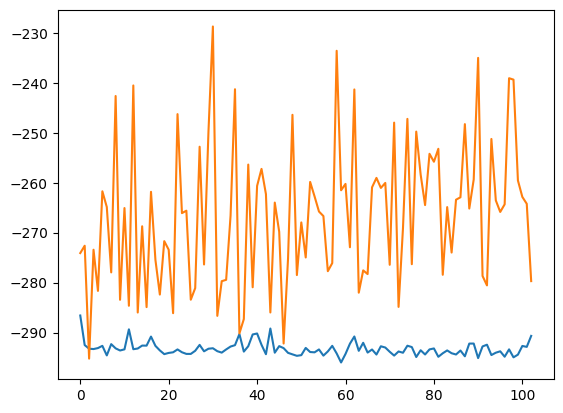

train_weighted_vae: dec
train: iter 0  trainloss -294.61702  validloss -249.76229±0.00000  bestvalidloss -249.76229  last_update 0
train: iter 1  trainloss -292.70957  validloss -247.11617±0.00000  bestvalidloss -249.76229  last_update 1
train: iter 2  trainloss -297.85554  validloss -243.68338±0.00000  bestvalidloss -249.76229  last_update 2
train: iter 3  trainloss -297.61776  validloss -239.88328±0.00000  bestvalidloss -249.76229  last_update 3
train: iter 4  trainloss -298.48136  validloss -232.09952±0.00000  bestvalidloss -249.76229  last_update 4
train: iter 5  trainloss -298.79412  validloss -245.97446±0.00000  bestvalidloss -249.76229  last_update 5
train: iter 6  trainloss -297.19401  validloss -236.54327±0.00000  bestvalidloss -249.76229  last_update 6
train: iter 7  trainloss -296.87500  validloss -236.23864±0.00000  bestvalidloss -249.76229  last_update 7
train: iter 8  trainloss -290.17709  validloss -231.59096±0.00000  bestvalidloss -249.76229  last_update 8
train: iter 9

train: iter 76  trainloss -294.60266  validloss -231.00592±0.00000  bestvalidloss -267.28687  last_update 8
train: iter 77  trainloss -295.02986  validloss -243.51938±0.00000  bestvalidloss -267.28687  last_update 9
train: iter 78  trainloss -298.96748  validloss -216.87820±0.00000  bestvalidloss -267.28687  last_update 10
train: iter 79  trainloss -301.35036  validloss -236.27173±0.00000  bestvalidloss -267.28687  last_update 11
train: iter 80  trainloss -295.00568  validloss -232.91695±0.00000  bestvalidloss -267.28687  last_update 12
train: iter 81  trainloss -298.90221  validloss -225.18802±0.00000  bestvalidloss -267.28687  last_update 13
train: iter 82  trainloss -299.99019  validloss -213.84091±0.00000  bestvalidloss -267.28687  last_update 14
train: iter 83  trainloss -297.38650  validloss -245.59486±0.00000  bestvalidloss -267.28687  last_update 15
train: iter 84  trainloss -294.26357  validloss -240.71820±0.00000  bestvalidloss -267.28687  last_update 16
train: iter 85  train

train: iter 151  trainloss -292.13230  validloss -231.47981±0.00000  bestvalidloss -267.28687  last_update 83
train: iter 152  trainloss -298.54518  validloss -215.81412±0.00000  bestvalidloss -267.28687  last_update 84
train: iter 153  trainloss -300.13864  validloss -217.05803±0.00000  bestvalidloss -267.28687  last_update 85
train: iter 154  trainloss -298.31295  validloss -244.17407±0.00000  bestvalidloss -267.28687  last_update 86
train: iter 155  trainloss -297.22500  validloss -195.31367±0.00000  bestvalidloss -267.28687  last_update 87
train: iter 156  trainloss -298.83252  validloss -219.02547±0.00000  bestvalidloss -267.28687  last_update 88
train: iter 157  trainloss -297.04379  validloss -257.72751±0.00000  bestvalidloss -267.28687  last_update 89
train: iter 158  trainloss -300.44699  validloss -208.25014±0.00000  bestvalidloss -267.28687  last_update 90
train: iter 159  trainloss -297.05963  validloss -211.99913±0.00000  bestvalidloss -267.28687  last_update 91
train: ite

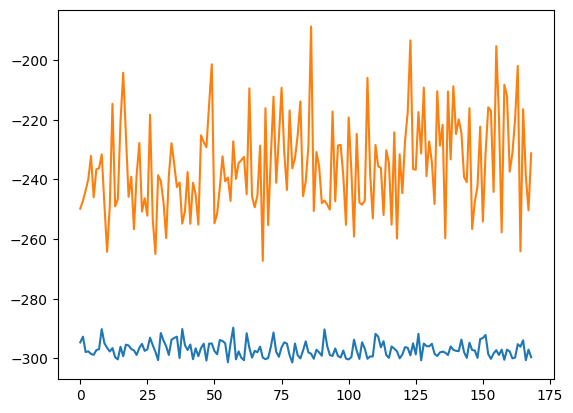

alpha 0.2 vae_lr 0.0005


In [38]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

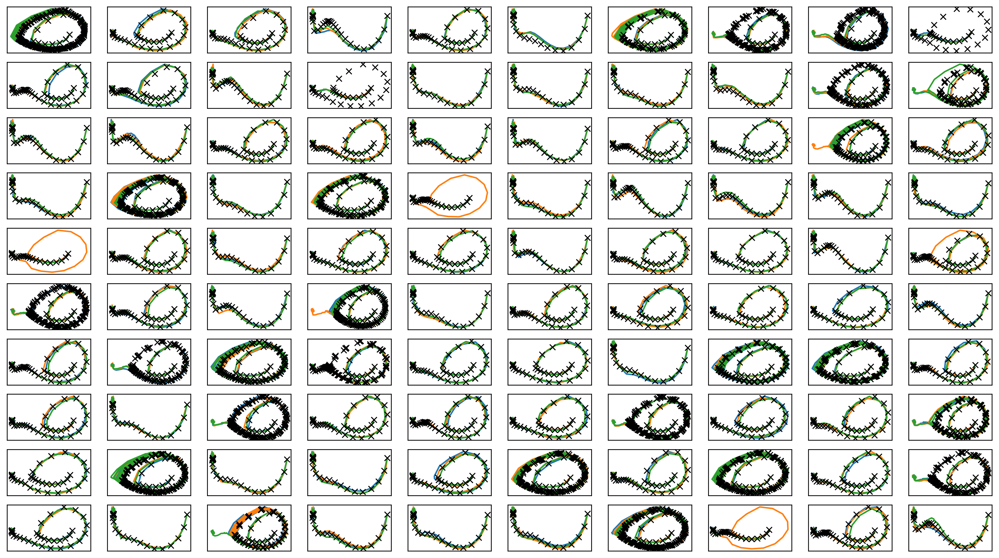

In [39]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter3.png")
plt.savefig(figfilenamehead+"joint_iter3.eps")
plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

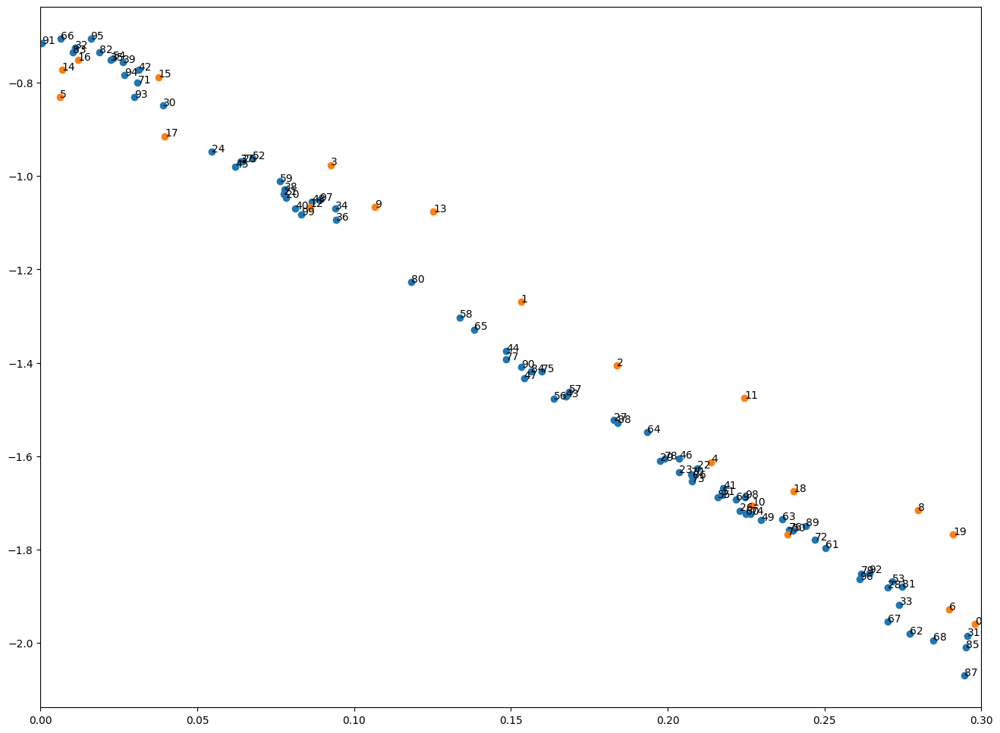

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [40]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter3.png")
plt.savefig(figfilenamehead+"damping_latent_iter3.eps")
plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [41]:
print(datetime.datetime.now())

2023-03-28 06:08:06.225065


# Iter 4

In [42]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [43]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.13443  validloss 0.15571±0.00000  bestvalidloss 0.15571  last_update 0
train: iter 1  trainloss 0.13188  validloss 0.15516±0.00000  bestvalidloss 0.15516  last_update 0
train: iter 2  trainloss 0.13170  validloss 0.15454±0.00000  bestvalidloss 0.15454  last_update 0
train: iter 3  trainloss 0.13380  validloss 0.15503±0.00000  bestvalidloss 0.15454  last_update 1
train: iter 4  trainloss 0.13050  validloss 0.15198±0.00000  bestvalidloss 0.15198  last_update 0
train: iter 5  trainloss 0.13108  validloss 0.15246±0.00000  bestvalidloss 0.15198  last_update 1
train: iter 6  trainloss 0.13076  validloss 0.15323±0.00000  bestvalidloss 0.15198  last_update 2
train: iter 7  trainloss 0.13057  validloss 0.15397±0.00000  bestvalidloss 0.15198  last_update 3
train: iter 8  trainloss 0.13127  validloss 0.15295±0.00000  bestvalidloss 0.15198  last_update 4
train: iter 9  trainloss 0.12991  validloss 0.15323±0.00000  bestvalidloss 0.15198  last_update 5
train: iter 10  trai

train: iter 84  trainloss 0.12786  validloss 0.15191±0.00000  bestvalidloss 0.15000  last_update 17
train: iter 85  trainloss 0.12897  validloss 0.15100±0.00000  bestvalidloss 0.15000  last_update 18
train: iter 86  trainloss 0.12774  validloss 0.15213±0.00000  bestvalidloss 0.15000  last_update 19
train: iter 87  trainloss 0.13116  validloss 0.15102±0.00000  bestvalidloss 0.15000  last_update 20
train: iter 88  trainloss 0.12801  validloss 0.15486±0.00000  bestvalidloss 0.15000  last_update 21
train: iter 89  trainloss 0.12700  validloss 0.15066±0.00000  bestvalidloss 0.15000  last_update 22
train: iter 90  trainloss 0.12807  validloss 0.15378±0.00000  bestvalidloss 0.15000  last_update 23
train: iter 91  trainloss 0.12723  validloss 0.15242±0.00000  bestvalidloss 0.15000  last_update 24
train: iter 92  trainloss 0.12872  validloss 0.15098±0.00000  bestvalidloss 0.15000  last_update 25
train: iter 93  trainloss 0.12903  validloss 0.15384±0.00000  bestvalidloss 0.15000  last_update 26


train: iter 168  trainloss 0.12715  validloss 0.15163±0.00000  bestvalidloss 0.14950  last_update 58
train: iter 169  trainloss 0.12634  validloss 0.15005±0.00000  bestvalidloss 0.14950  last_update 59
train: iter 170  trainloss 0.12602  validloss 0.14989±0.00000  bestvalidloss 0.14950  last_update 60
train: iter 171  trainloss 0.12793  validloss 0.15637±0.00000  bestvalidloss 0.14950  last_update 61
train: iter 172  trainloss 0.12669  validloss 0.15308±0.00000  bestvalidloss 0.14950  last_update 62
train: iter 173  trainloss 0.12640  validloss 0.15075±0.00000  bestvalidloss 0.14950  last_update 63
train: iter 174  trainloss 0.12655  validloss 0.15166±0.00000  bestvalidloss 0.14950  last_update 64
train: iter 175  trainloss 0.12847  validloss 0.15159±0.00000  bestvalidloss 0.14950  last_update 65
train: iter 176  trainloss 0.12643  validloss 0.15193±0.00000  bestvalidloss 0.14950  last_update 66
train: iter 177  trainloss 0.12569  validloss 0.15250±0.00000  bestvalidloss 0.14950  last_

train: iter 251  trainloss 0.12646  validloss 0.15196±0.00000  bestvalidloss 0.14894  last_update 37
train: iter 252  trainloss 0.12688  validloss 0.15188±0.00000  bestvalidloss 0.14894  last_update 38
train: iter 253  trainloss 0.12600  validloss 0.15249±0.00000  bestvalidloss 0.14894  last_update 39
train: iter 254  trainloss 0.12600  validloss 0.15134±0.00000  bestvalidloss 0.14894  last_update 40
train: iter 255  trainloss 0.12534  validloss 0.15145±0.00000  bestvalidloss 0.14894  last_update 41
train: iter 256  trainloss 0.12570  validloss 0.15230±0.00000  bestvalidloss 0.14894  last_update 42
train: iter 257  trainloss 0.12484  validloss 0.14933±0.00000  bestvalidloss 0.14894  last_update 43
train: iter 258  trainloss 0.12642  validloss 0.15103±0.00000  bestvalidloss 0.14894  last_update 44
train: iter 259  trainloss 0.12523  validloss 0.15154±0.00000  bestvalidloss 0.14894  last_update 45
train: iter 260  trainloss 0.12880  validloss 0.15074±0.00000  bestvalidloss 0.14894  last_

train: iter 335  trainloss 0.12577  validloss 0.15709±0.00000  bestvalidloss 0.14849  last_update 7
train: iter 336  trainloss 0.12506  validloss 0.15060±0.00000  bestvalidloss 0.14849  last_update 8
train: iter 337  trainloss 0.12510  validloss 0.14907±0.00000  bestvalidloss 0.14849  last_update 9
train: iter 338  trainloss 0.12579  validloss 0.15058±0.00000  bestvalidloss 0.14849  last_update 10
train: iter 339  trainloss 0.12468  validloss 0.15528±0.00000  bestvalidloss 0.14849  last_update 11
train: iter 340  trainloss 0.12448  validloss 0.15264±0.00000  bestvalidloss 0.14849  last_update 12
train: iter 341  trainloss 0.12411  validloss 0.15084±0.00000  bestvalidloss 0.14849  last_update 13
train: iter 342  trainloss 0.12491  validloss 0.15193±0.00000  bestvalidloss 0.14849  last_update 14
train: iter 343  trainloss 0.12454  validloss 0.15195±0.00000  bestvalidloss 0.14849  last_update 15
train: iter 344  trainloss 0.12401  validloss 0.14906±0.00000  bestvalidloss 0.14849  last_upd

train: iter 419  trainloss 0.12427  validloss 0.14840±0.00000  bestvalidloss 0.14840  last_update 0
train: iter 420  trainloss 0.12577  validloss 0.15010±0.00000  bestvalidloss 0.14840  last_update 1
train: iter 421  trainloss 0.12426  validloss 0.15099±0.00000  bestvalidloss 0.14840  last_update 2
train: iter 422  trainloss 0.12357  validloss 0.15005±0.00000  bestvalidloss 0.14840  last_update 3
train: iter 423  trainloss 0.12497  validloss 0.14986±0.00000  bestvalidloss 0.14840  last_update 4
train: iter 424  trainloss 0.12687  validloss 0.15722±0.00000  bestvalidloss 0.14840  last_update 5
train: iter 425  trainloss 0.12452  validloss 0.15027±0.00000  bestvalidloss 0.14840  last_update 6
train: iter 426  trainloss 0.12506  validloss 0.15526±0.00000  bestvalidloss 0.14840  last_update 7
train: iter 427  trainloss 0.12344  validloss 0.14977±0.00000  bestvalidloss 0.14840  last_update 8
train: iter 428  trainloss 0.12385  validloss 0.15088±0.00000  bestvalidloss 0.14840  last_update 9


train: iter 503  trainloss 0.12393  validloss 0.15072±0.00000  bestvalidloss 0.14837  last_update 15
train: iter 504  trainloss 0.12584  validloss 0.15605±0.00000  bestvalidloss 0.14837  last_update 16
train: iter 505  trainloss 0.12323  validloss 0.15359±0.00000  bestvalidloss 0.14837  last_update 17
train: iter 506  trainloss 0.12368  validloss 0.15033±0.00000  bestvalidloss 0.14837  last_update 18
train: iter 507  trainloss 0.12295  validloss 0.14940±0.00000  bestvalidloss 0.14837  last_update 19
train: iter 508  trainloss 0.12321  validloss 0.15323±0.00000  bestvalidloss 0.14837  last_update 20
train: iter 509  trainloss 0.12421  validloss 0.15127±0.00000  bestvalidloss 0.14837  last_update 21
train: iter 510  trainloss 0.12449  validloss 0.15494±0.00000  bestvalidloss 0.14837  last_update 22
train: iter 511  trainloss 0.12320  validloss 0.15295±0.00000  bestvalidloss 0.14837  last_update 23
train: iter 512  trainloss 0.12321  validloss 0.15323±0.00000  bestvalidloss 0.14837  last_

train: iter 587  trainloss 0.12373  validloss 0.15056±0.00000  bestvalidloss 0.14837  last_update 99
train: iter 588  trainloss 0.12390  validloss 0.15431±0.00000  bestvalidloss 0.14837  last_update 100
train: fin


In [44]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -180.0346201264858
valid_loss:  -174.8561526489258
train_loss:  -278.57326179265976
valid_loss:  -223.97112480163577


1e-08 1000.0


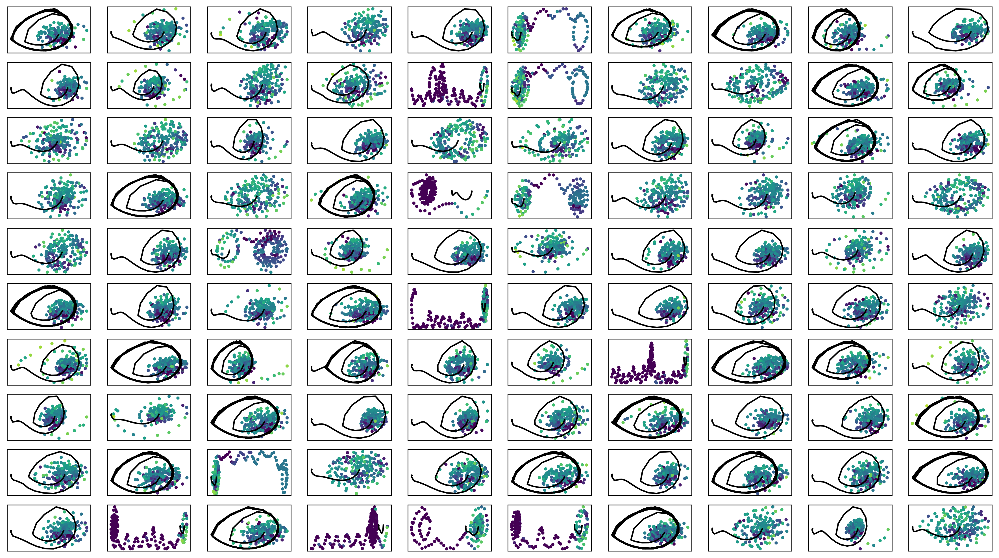

In [45]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter4.png")

In [46]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [47]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [48]:
# i = 35
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -271.85480  validloss -224.97084±0.00000  bestvalidloss -224.97084  last_update 0
train: iter 1  trainloss -274.68641  validloss -229.69524±0.00000  bestvalidloss -229.69524  last_update 0
train: iter 2  trainloss -269.51486  validloss -220.62178±0.00000  bestvalidloss -229.69524  last_update 1
train: iter 3  trainloss -275.40600  validloss -243.55277±0.00000  bestvalidloss -243.55277  last_update 0
train: iter 4  trainloss -270.81209  validloss -215.91218±0.00000  bestvalidloss -243.55277  last_update 1
train: iter 5  trainloss -276.35701  validloss -235.25507±0.00000  bestvalidloss -243.55277  last_update 2
train: iter 6  trainloss -272.84342  validloss -204.27220±0.00000  bestvalidloss -243.55277  last_update 3
train: iter 7  trainloss -272.74559  validloss -255.73072±0.00000  bestvalidloss -255.73072  last_update 0
train: iter 8  trainloss -267.95861  validloss -195.02106±0.00000  bestvalidloss -255.73072  last_update 1
train: it

train: iter 76  trainloss -279.80784  validloss -223.10940±0.00000  bestvalidloss -271.67900  last_update 22
train: iter 77  trainloss -273.51764  validloss -232.85669±0.00000  bestvalidloss -271.67900  last_update 23
train: iter 78  trainloss -271.30650  validloss -223.25224±0.00000  bestvalidloss -271.67900  last_update 24
train: iter 79  trainloss -277.24534  validloss -258.14266±0.00000  bestvalidloss -271.67900  last_update 25
train: iter 80  trainloss -272.31658  validloss -229.17698±0.00000  bestvalidloss -271.67900  last_update 26
train: iter 81  trainloss -271.49268  validloss -223.02979±0.00000  bestvalidloss -271.67900  last_update 27
train: iter 82  trainloss -269.89172  validloss -230.89385±0.00000  bestvalidloss -271.67900  last_update 28
train: iter 83  trainloss -262.66173  validloss -251.79541±0.00000  bestvalidloss -271.67900  last_update 29
train: iter 84  trainloss -275.76918  validloss -262.51370±0.00000  bestvalidloss -271.67900  last_update 30
train: iter 85  tra

train: iter 151  trainloss -269.78537  validloss -173.33854±0.00000  bestvalidloss -275.67737  last_update 37
train: iter 152  trainloss -280.44168  validloss -238.58305±0.00000  bestvalidloss -275.67737  last_update 38
train: iter 153  trainloss -266.17664  validloss -227.42541±0.00000  bestvalidloss -275.67737  last_update 39
train: iter 154  trainloss -275.93158  validloss -185.38241±0.00000  bestvalidloss -275.67737  last_update 40
train: iter 155  trainloss -275.16917  validloss -219.77733±0.00000  bestvalidloss -275.67737  last_update 41
train: iter 156  trainloss -275.61806  validloss -253.32792±0.00000  bestvalidloss -275.67737  last_update 42
train: iter 157  trainloss -265.71845  validloss -186.33211±0.00000  bestvalidloss -275.67737  last_update 43
train: iter 158  trainloss -272.11885  validloss -222.52461±0.00000  bestvalidloss -275.67737  last_update 44
train: iter 159  trainloss -276.29031  validloss -212.80675±0.00000  bestvalidloss -275.67737  last_update 45
train: ite

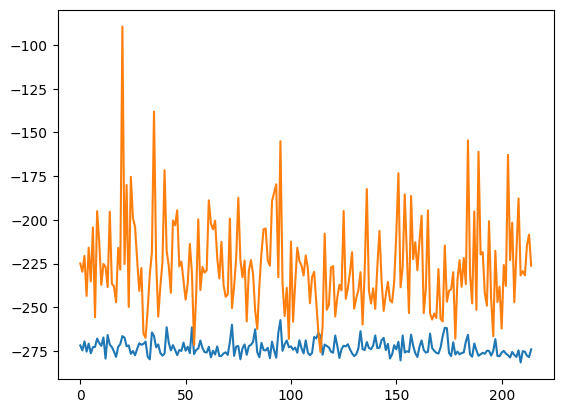

train_weighted_vae: enc
train: iter 0  trainloss -277.01204  validloss -189.41168±0.00000  bestvalidloss -189.41168  last_update 0
train: iter 1  trainloss -282.55214  validloss -222.27410±0.00000  bestvalidloss -222.27410  last_update 0
train: iter 2  trainloss -282.44699  validloss -235.62846±0.00000  bestvalidloss -235.62846  last_update 0
train: iter 3  trainloss -278.59846  validloss -222.86107±0.00000  bestvalidloss -235.62846  last_update 1
train: iter 4  trainloss -273.18170  validloss -264.15959±0.00000  bestvalidloss -264.15959  last_update 0
train: iter 5  trainloss -279.42407  validloss -239.61079±0.00000  bestvalidloss -264.15959  last_update 1
train: iter 6  trainloss -281.37772  validloss -239.70609±0.00000  bestvalidloss -264.15959  last_update 2
train: iter 7  trainloss -282.46595  validloss -224.72152±0.00000  bestvalidloss -264.15959  last_update 3
train: iter 8  trainloss -282.94720  validloss -218.08018±0.00000  bestvalidloss -264.15959  last_update 4
train: iter 9

train: iter 76  trainloss -278.59315  validloss -228.56940±0.00000  bestvalidloss -271.60468  last_update 60
train: iter 77  trainloss -282.83501  validloss -247.45215±0.00000  bestvalidloss -271.60468  last_update 61
train: iter 78  trainloss -280.16716  validloss -209.08058±0.00000  bestvalidloss -271.60468  last_update 62
train: iter 79  trainloss -278.41803  validloss -250.70963±0.00000  bestvalidloss -271.60468  last_update 63
train: iter 80  trainloss -282.09767  validloss -240.78143±0.00000  bestvalidloss -271.60468  last_update 64
train: iter 81  trainloss -284.63957  validloss -236.97174±0.00000  bestvalidloss -271.60468  last_update 65
train: iter 82  trainloss -280.52195  validloss -248.83992±0.00000  bestvalidloss -271.60468  last_update 66
train: iter 83  trainloss -283.02059  validloss -236.40513±0.00000  bestvalidloss -271.60468  last_update 67
train: iter 84  trainloss -281.95366  validloss -228.17095±0.00000  bestvalidloss -271.60468  last_update 68
train: iter 85  tra

train: iter 151  trainloss -282.21963  validloss -226.46723±0.00000  bestvalidloss -279.83486  last_update 39
train: iter 152  trainloss -283.72527  validloss -237.91268±0.00000  bestvalidloss -279.83486  last_update 40
train: iter 153  trainloss -283.60456  validloss -246.11861±0.00000  bestvalidloss -279.83486  last_update 41
train: iter 154  trainloss -280.68151  validloss -218.56845±0.00000  bestvalidloss -279.83486  last_update 42
train: iter 155  trainloss -280.01737  validloss -258.27759±0.00000  bestvalidloss -279.83486  last_update 43
train: iter 156  trainloss -281.92925  validloss -206.39275±0.00000  bestvalidloss -279.83486  last_update 44
train: iter 157  trainloss -283.56194  validloss -250.57759±0.00000  bestvalidloss -279.83486  last_update 45
train: iter 158  trainloss -283.95226  validloss -206.88670±0.00000  bestvalidloss -279.83486  last_update 46
train: iter 159  trainloss -283.21145  validloss -223.71970±0.00000  bestvalidloss -279.83486  last_update 47
train: ite

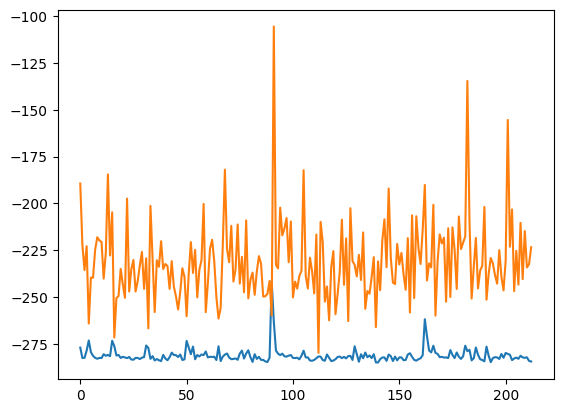

train_weighted_vae: dec
train: iter 0  trainloss -277.92884  validloss -256.01764±0.00000  bestvalidloss -256.01764  last_update 0
train: iter 1  trainloss -286.63731  validloss -238.63073±0.00000  bestvalidloss -256.01764  last_update 1
train: iter 2  trainloss -284.54493  validloss -235.51187±0.00000  bestvalidloss -256.01764  last_update 2
train: iter 3  trainloss -285.05208  validloss -226.14734±0.00000  bestvalidloss -256.01764  last_update 3
train: iter 4  trainloss -286.38376  validloss -223.33839±0.00000  bestvalidloss -256.01764  last_update 4
train: iter 5  trainloss -285.59398  validloss -191.30347±0.00000  bestvalidloss -256.01764  last_update 5
train: iter 6  trainloss -285.22568  validloss -182.61565±0.00000  bestvalidloss -256.01764  last_update 6
train: iter 7  trainloss -285.90418  validloss -228.00043±0.00000  bestvalidloss -256.01764  last_update 7
train: iter 8  trainloss -284.61917  validloss -205.55097±0.00000  bestvalidloss -256.01764  last_update 8
train: iter 9

train: iter 77  trainloss -285.49077  validloss -225.82229±0.00000  bestvalidloss -256.01764  last_update 77
train: iter 78  trainloss -278.47678  validloss -196.86916±0.00000  bestvalidloss -256.01764  last_update 78
train: iter 79  trainloss -285.93334  validloss -240.83180±0.00000  bestvalidloss -256.01764  last_update 79
train: iter 80  trainloss -285.26969  validloss -198.56725±0.00000  bestvalidloss -256.01764  last_update 80
train: iter 81  trainloss -284.96580  validloss -225.65277±0.00000  bestvalidloss -256.01764  last_update 81
train: iter 82  trainloss -283.92218  validloss -180.44033±0.00000  bestvalidloss -256.01764  last_update 82
train: iter 83  trainloss -285.98856  validloss -198.62691±0.00000  bestvalidloss -256.01764  last_update 83
train: iter 84  trainloss -286.52740  validloss -199.15048±0.00000  bestvalidloss -256.01764  last_update 84
train: iter 85  trainloss -284.78844  validloss -210.82627±0.00000  bestvalidloss -256.01764  last_update 85
train: iter 86  tra

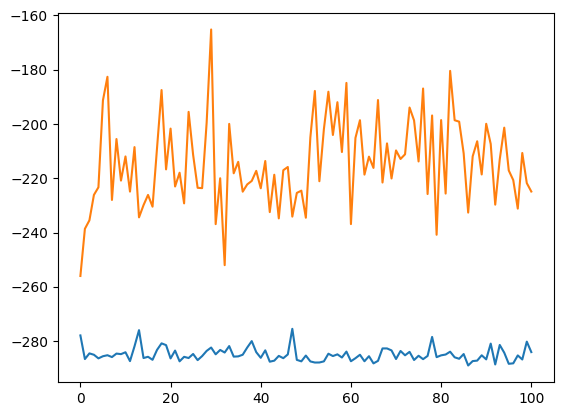

alpha 0.2 vae_lr 0.0005


In [49]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

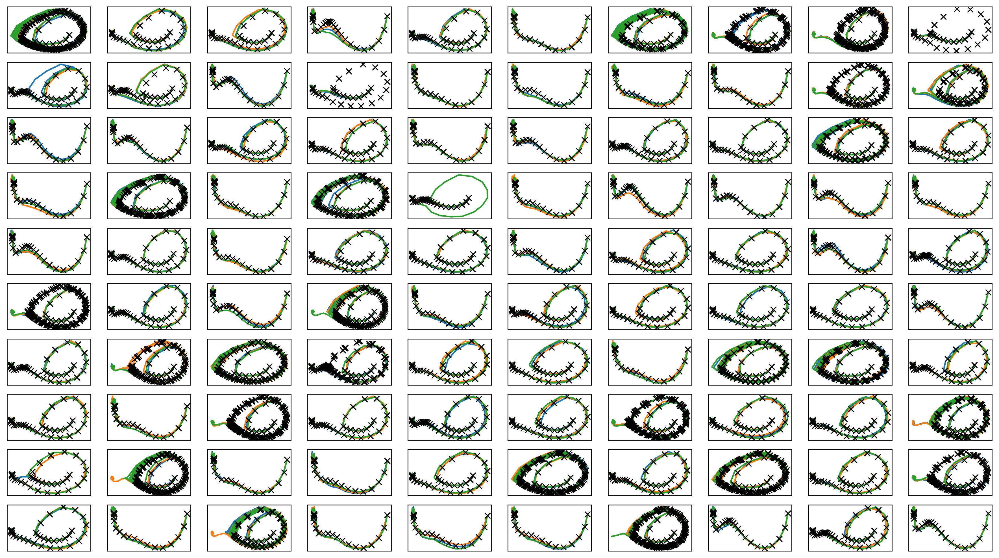

In [50]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter4.png")
plt.savefig(figfilenamehead+"joint_iter4.eps")
plt.savefig(figfilenamehead+"joint_iter4.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

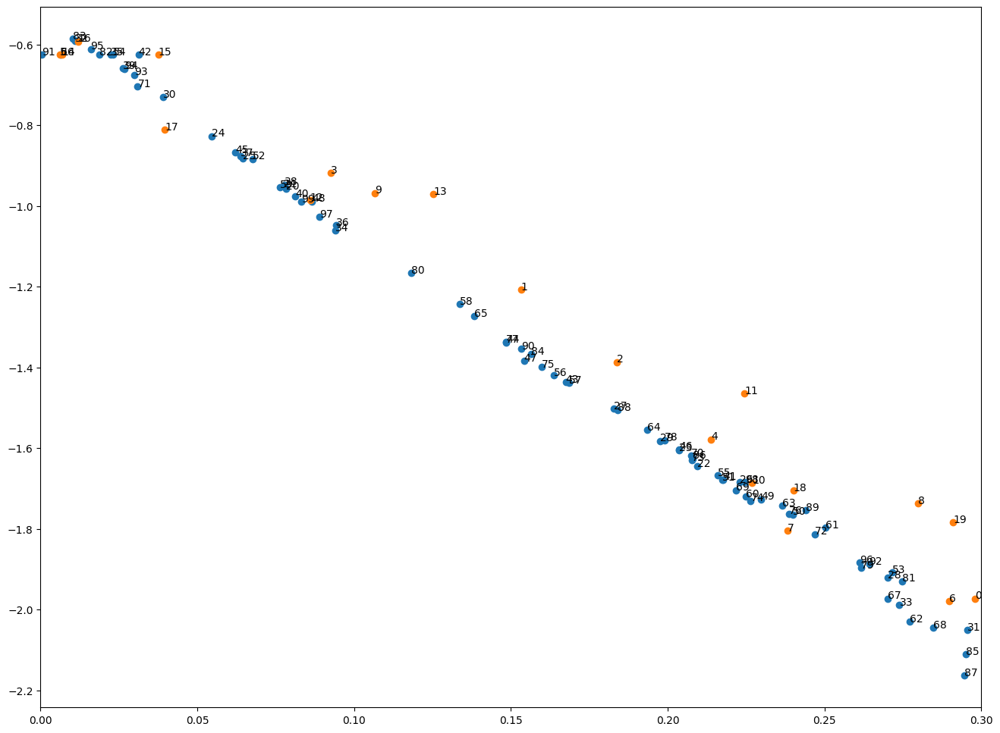

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [51]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter4.png")
plt.savefig(figfilenamehead+"damping_latent_iter4.eps")
plt.savefig(figfilenamehead+"damping_latent_iter4.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])

# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [52]:
print(datetime.datetime.now())

2023-03-28 06:13:20.533168


# Iter5

In [53]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [54]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.12068  validloss 0.14076±0.00000  bestvalidloss 0.14076  last_update 0
train: iter 1  trainloss 0.11944  validloss 0.14290±0.00000  bestvalidloss 0.14076  last_update 1
train: iter 2  trainloss 0.11992  validloss 0.14298±0.00000  bestvalidloss 0.14076  last_update 2
train: iter 3  trainloss 0.11911  validloss 0.14070±0.00000  bestvalidloss 0.14070  last_update 0
train: iter 4  trainloss 0.11856  validloss 0.14001±0.00000  bestvalidloss 0.14001  last_update 0
train: iter 5  trainloss 0.12073  validloss 0.14226±0.00000  bestvalidloss 0.14001  last_update 1
train: iter 6  trainloss 0.11885  validloss 0.14248±0.00000  bestvalidloss 0.14001  last_update 2
train: iter 7  trainloss 0.11832  validloss 0.14753±0.00000  bestvalidloss 0.14001  last_update 3
train: iter 8  trainloss 0.11850  validloss 0.14136±0.00000  bestvalidloss 0.14001  last_update 4
train: iter 9  trainloss 0.11925  validloss 0.14846±0.00000  bestvalidloss 0.14001  last_update 5
train: iter 10  trai

train: iter 84  trainloss 0.11718  validloss 0.14362±0.00000  bestvalidloss 0.13955  last_update 41
train: iter 85  trainloss 0.11630  validloss 0.14898±0.00000  bestvalidloss 0.13955  last_update 42
train: iter 86  trainloss 0.11683  validloss 0.14247±0.00000  bestvalidloss 0.13955  last_update 43
train: iter 87  trainloss 0.11524  validloss 0.14067±0.00000  bestvalidloss 0.13955  last_update 44
train: iter 88  trainloss 0.11586  validloss 0.14580±0.00000  bestvalidloss 0.13955  last_update 45
train: iter 89  trainloss 0.11677  validloss 0.14143±0.00000  bestvalidloss 0.13955  last_update 46
train: iter 90  trainloss 0.11791  validloss 0.14287±0.00000  bestvalidloss 0.13955  last_update 47
train: iter 91  trainloss 0.11674  validloss 0.14293±0.00000  bestvalidloss 0.13955  last_update 48
train: iter 92  trainloss 0.11655  validloss 0.14199±0.00000  bestvalidloss 0.13955  last_update 49
train: iter 93  trainloss 0.11530  validloss 0.14169±0.00000  bestvalidloss 0.13955  last_update 50


train: iter 166  trainloss 0.11530  validloss 0.14140±0.00000  bestvalidloss 0.13909  last_update 31
train: iter 167  trainloss 0.11432  validloss 0.14112±0.00000  bestvalidloss 0.13909  last_update 32
train: iter 168  trainloss 0.11649  validloss 0.14142±0.00000  bestvalidloss 0.13909  last_update 33
train: iter 169  trainloss 0.11573  validloss 0.14326±0.00000  bestvalidloss 0.13909  last_update 34
train: iter 170  trainloss 0.11397  validloss 0.14210±0.00000  bestvalidloss 0.13909  last_update 35
train: iter 171  trainloss 0.11552  validloss 0.15126±0.00000  bestvalidloss 0.13909  last_update 36
train: iter 172  trainloss 0.11553  validloss 0.14225±0.00000  bestvalidloss 0.13909  last_update 37
train: iter 173  trainloss 0.11459  validloss 0.14084±0.00000  bestvalidloss 0.13909  last_update 38
train: iter 174  trainloss 0.11463  validloss 0.14190±0.00000  bestvalidloss 0.13909  last_update 39
train: iter 175  trainloss 0.11480  validloss 0.14031±0.00000  bestvalidloss 0.13909  last_

train: iter 250  trainloss 0.11465  validloss 0.14412±0.00000  bestvalidloss 0.13846  last_update 47
train: iter 251  trainloss 0.11283  validloss 0.14463±0.00000  bestvalidloss 0.13846  last_update 48
train: iter 252  trainloss 0.11479  validloss 0.14730±0.00000  bestvalidloss 0.13846  last_update 49
train: iter 253  trainloss 0.11464  validloss 0.14282±0.00000  bestvalidloss 0.13846  last_update 50
train: iter 254  trainloss 0.11572  validloss 0.13990±0.00000  bestvalidloss 0.13846  last_update 51
train: iter 255  trainloss 0.11431  validloss 0.14705±0.00000  bestvalidloss 0.13846  last_update 52
train: iter 256  trainloss 0.11411  validloss 0.14016±0.00000  bestvalidloss 0.13846  last_update 53
train: iter 257  trainloss 0.11501  validloss 0.14188±0.00000  bestvalidloss 0.13846  last_update 54
train: iter 258  trainloss 0.11448  validloss 0.14696±0.00000  bestvalidloss 0.13846  last_update 55
train: iter 259  trainloss 0.11561  validloss 0.14201±0.00000  bestvalidloss 0.13846  last_

In [55]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -159.96502784013745
valid_loss:  -128.8072813415527
train_loss:  -244.28110582828518
valid_loss:  -172.90678733825683


1e-08 1000.0


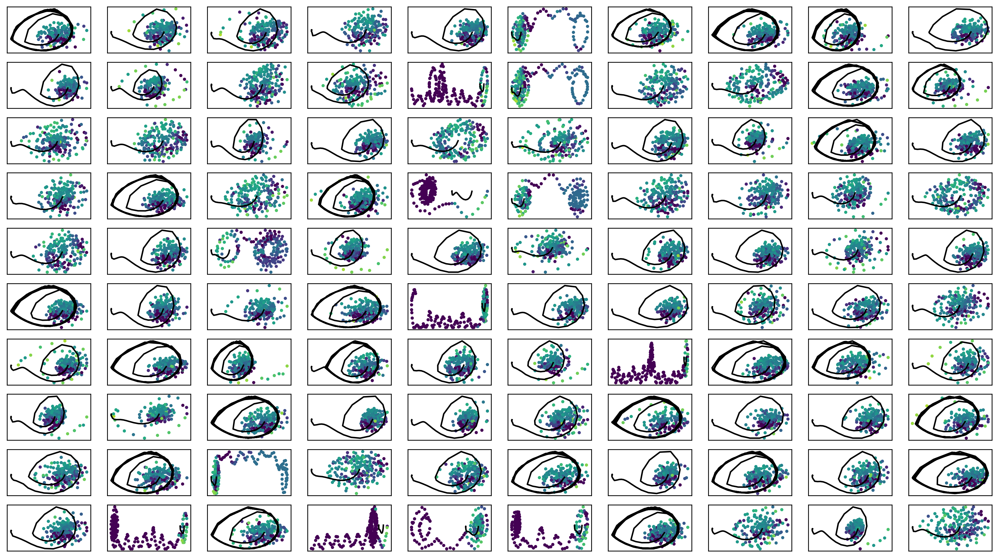

In [56]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter5.png")

In [57]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [58]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -232.62441  validloss -172.27441±0.00000  bestvalidloss -172.27441  last_update 0
train: iter 1  trainloss -239.10991  validloss -174.22175±0.00000  bestvalidloss -174.22175  last_update 0
train: iter 2  trainloss -239.32845  validloss -190.89747±0.00000  bestvalidloss -190.89747  last_update 0
train: iter 3  trainloss -239.60367  validloss -183.57750±0.00000  bestvalidloss -190.89747  last_update 1
train: iter 4  trainloss -240.68771  validloss -196.90064±0.00000  bestvalidloss -196.90064  last_update 0
train: iter 5  trainloss -242.13671  validloss -194.82924±0.00000  bestvalidloss -196.90064  last_update 1
train: iter 6  trainloss -238.12074  validloss -177.25832±0.00000  bestvalidloss -196.90064  last_update 2
train: iter 7  trainloss -238.77460  validloss -196.45951±0.00000  bestvalidloss -196.90064  last_update 3
train: iter 8  trainloss -241.77659  validloss -181.65298±0.00000  bestvalidloss -196.90064  last_update 4
train: it

train: iter 76  trainloss -242.69170  validloss -162.15680±0.00000  bestvalidloss -220.46488  last_update 6
train: iter 77  trainloss -244.66549  validloss -189.64832±0.00000  bestvalidloss -220.46488  last_update 7
train: iter 78  trainloss -237.79408  validloss -174.58661±0.00000  bestvalidloss -220.46488  last_update 8
train: iter 79  trainloss -233.68447  validloss -142.30515±0.00000  bestvalidloss -220.46488  last_update 9
train: iter 80  trainloss -240.21546  validloss -151.25702±0.00000  bestvalidloss -220.46488  last_update 10
train: iter 81  trainloss -198.86694  validloss -172.01033±0.00000  bestvalidloss -220.46488  last_update 11
train: iter 82  trainloss -220.91792  validloss -70.11789±0.00000  bestvalidloss -220.46488  last_update 12
train: iter 83  trainloss -233.86394  validloss -216.81815±0.00000  bestvalidloss -220.46488  last_update 13
train: iter 84  trainloss -238.36191  validloss -205.51932±0.00000  bestvalidloss -220.46488  last_update 14
train: iter 85  trainlos

train: iter 151  trainloss -240.00724  validloss -160.94205±0.00000  bestvalidloss -231.65610  last_update 63
train: iter 152  trainloss -243.74994  validloss -190.33084±0.00000  bestvalidloss -231.65610  last_update 64
train: iter 153  trainloss -240.10310  validloss -173.69614±0.00000  bestvalidloss -231.65610  last_update 65
train: iter 154  trainloss -239.38161  validloss -160.99393±0.00000  bestvalidloss -231.65610  last_update 66
train: iter 155  trainloss -232.44500  validloss -132.46380±0.00000  bestvalidloss -231.65610  last_update 67
train: iter 156  trainloss -233.34529  validloss -197.96859±0.00000  bestvalidloss -231.65610  last_update 68
train: iter 157  trainloss -236.91960  validloss -184.63014±0.00000  bestvalidloss -231.65610  last_update 69
train: iter 158  trainloss -239.26653  validloss -196.77634±0.00000  bestvalidloss -231.65610  last_update 70
train: iter 159  trainloss -243.04268  validloss -194.66474±0.00000  bestvalidloss -231.65610  last_update 71
train: ite

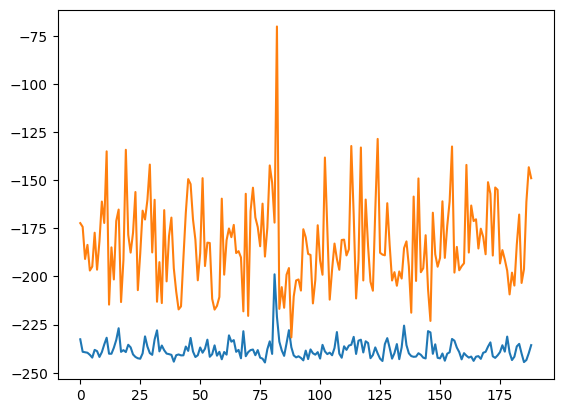

train_weighted_vae: enc
train: iter 0  trainloss -240.65043  validloss -186.01572±0.00000  bestvalidloss -186.01572  last_update 0
train: iter 1  trainloss -241.57203  validloss -193.71843±0.00000  bestvalidloss -193.71843  last_update 0
train: iter 2  trainloss -243.68477  validloss -172.14092±0.00000  bestvalidloss -193.71843  last_update 1
train: iter 3  trainloss -241.53920  validloss -135.75469±0.00000  bestvalidloss -193.71843  last_update 2
train: iter 4  trainloss -238.49528  validloss -173.90230±0.00000  bestvalidloss -193.71843  last_update 3
train: iter 5  trainloss -242.46122  validloss -167.52033±0.00000  bestvalidloss -193.71843  last_update 4
train: iter 6  trainloss -230.64019  validloss -212.75222±0.00000  bestvalidloss -212.75222  last_update 0
train: iter 7  trainloss -237.83398  validloss -179.21236±0.00000  bestvalidloss -212.75222  last_update 1
train: iter 8  trainloss -241.18186  validloss -163.00028±0.00000  bestvalidloss -212.75222  last_update 2
train: iter 9

train: iter 76  trainloss -233.67717  validloss -186.16478±0.00000  bestvalidloss -212.75222  last_update 70
train: iter 77  trainloss -227.60315  validloss -200.62789±0.00000  bestvalidloss -212.75222  last_update 71
train: iter 78  trainloss -234.87020  validloss -181.59927±0.00000  bestvalidloss -212.75222  last_update 72
train: iter 79  trainloss -235.59266  validloss -177.34992±0.00000  bestvalidloss -212.75222  last_update 73
train: iter 80  trainloss -237.58539  validloss -207.73171±0.00000  bestvalidloss -212.75222  last_update 74
train: iter 81  trainloss -235.70773  validloss -191.11987±0.00000  bestvalidloss -212.75222  last_update 75
train: iter 82  trainloss -238.03315  validloss -181.58396±0.00000  bestvalidloss -212.75222  last_update 76
train: iter 83  trainloss -235.20155  validloss -189.39829±0.00000  bestvalidloss -212.75222  last_update 77
train: iter 84  trainloss -235.44177  validloss -190.08486±0.00000  bestvalidloss -212.75222  last_update 78
train: iter 85  tra

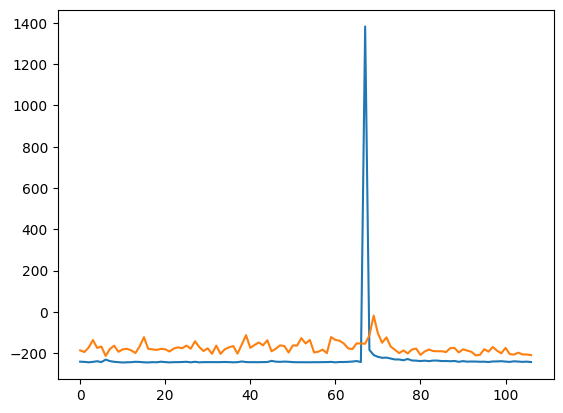

train_weighted_vae: dec
train: iter 0  trainloss -238.38916  validloss -196.89787±0.00000  bestvalidloss -196.89787  last_update 0
train: iter 1  trainloss -241.50093  validloss -187.05593±0.00000  bestvalidloss -196.89787  last_update 1
train: iter 2  trainloss -241.10406  validloss -205.88756±0.00000  bestvalidloss -205.88756  last_update 0
train: iter 3  trainloss -240.06217  validloss -158.43653±0.00000  bestvalidloss -205.88756  last_update 1
train: iter 4  trainloss -240.43967  validloss -185.05013±0.00000  bestvalidloss -205.88756  last_update 2
train: iter 5  trainloss -241.10295  validloss -190.27878±0.00000  bestvalidloss -205.88756  last_update 3
train: iter 6  trainloss -241.55254  validloss -155.64872±0.00000  bestvalidloss -205.88756  last_update 4
train: iter 7  trainloss -242.51595  validloss -186.27042±0.00000  bestvalidloss -205.88756  last_update 5
train: iter 8  trainloss -240.23573  validloss -198.65556±0.00000  bestvalidloss -205.88756  last_update 6
train: iter 9

train: iter 77  trainloss -240.22560  validloss -145.22265±0.00000  bestvalidloss -206.73271  last_update 66
train: iter 78  trainloss -242.35272  validloss -185.38324±0.00000  bestvalidloss -206.73271  last_update 67
train: iter 79  trainloss -241.11103  validloss -190.73073±0.00000  bestvalidloss -206.73271  last_update 68
train: iter 80  trainloss -243.05289  validloss -189.70060±0.00000  bestvalidloss -206.73271  last_update 69
train: iter 81  trainloss -240.39556  validloss -181.40206±0.00000  bestvalidloss -206.73271  last_update 70
train: iter 82  trainloss -232.99829  validloss -170.38371±0.00000  bestvalidloss -206.73271  last_update 71
train: iter 83  trainloss -241.60205  validloss -198.91154±0.00000  bestvalidloss -206.73271  last_update 72
train: iter 84  trainloss -240.58163  validloss -180.78051±0.00000  bestvalidloss -206.73271  last_update 73
train: iter 85  trainloss -241.10796  validloss -199.47129±0.00000  bestvalidloss -206.73271  last_update 74
train: iter 86  tra

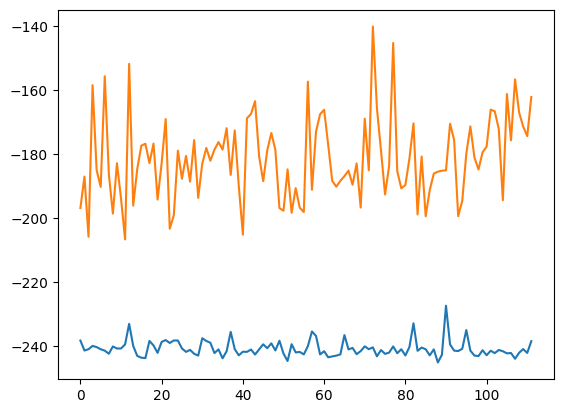

alpha 0.2 vae_lr 0.0005


In [59]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

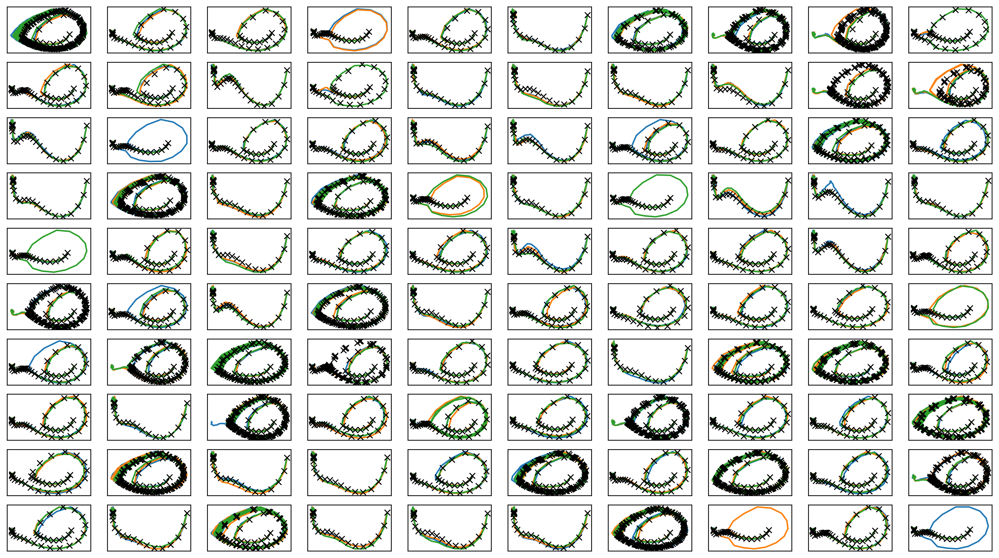

In [60]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter5.png")
plt.savefig(figfilenamehead+"joint_iter5.eps")
plt.savefig(figfilenamehead+"joint_iter5.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

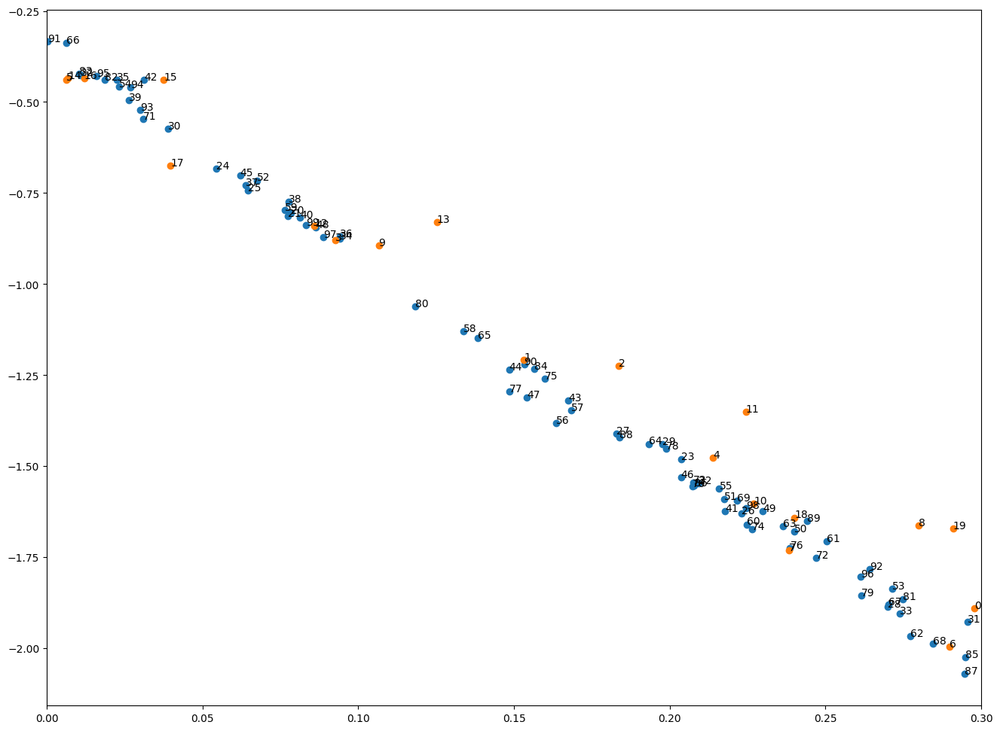

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [61]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter5.png")
plt.savefig(figfilenamehead+"damping_latent_iter5.eps")
plt.savefig(figfilenamehead+"damping_latent_iter5.pdf")

plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [62]:
print(datetime.datetime.now())

2023-03-28 06:17:30.773734


# 評価関数計算

In [63]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [64]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.13052  validloss 0.17290±0.00000  bestvalidloss 0.17290  last_update 0
train: iter 1  trainloss 0.13009  validloss 0.16381±0.00000  bestvalidloss 0.16381  last_update 0
train: iter 2  trainloss 0.12769  validloss 0.16644±0.00000  bestvalidloss 0.16381  last_update 1
train: iter 3  trainloss 0.12781  validloss 0.16520±0.00000  bestvalidloss 0.16381  last_update 2
train: iter 4  trainloss 0.12818  validloss 0.16490±0.00000  bestvalidloss 0.16381  last_update 3
train: iter 5  trainloss 0.12753  validloss 0.16453±0.00000  bestvalidloss 0.16381  last_update 4
train: iter 6  trainloss 0.12862  validloss 0.16144±0.00000  bestvalidloss 0.16144  last_update 0
train: iter 7  trainloss 0.12704  validloss 0.16535±0.00000  bestvalidloss 0.16144  last_update 1
train: iter 8  trainloss 0.12596  validloss 0.16451±0.00000  bestvalidloss 0.16144  last_update 2
train: iter 9  trainloss 0.12709  validloss 0.16130±0.00000  bestvalidloss 0.16130  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.12559  validloss 0.16347±0.00000  bestvalidloss 0.16015  last_update 13
train: iter 85  trainloss 0.12473  validloss 0.16188±0.00000  bestvalidloss 0.16015  last_update 14
train: iter 86  trainloss 0.12476  validloss 0.16090±0.00000  bestvalidloss 0.16015  last_update 15
train: iter 87  trainloss 0.12490  validloss 0.16146±0.00000  bestvalidloss 0.16015  last_update 16
train: iter 88  trainloss 0.12701  validloss 0.16856±0.00000  bestvalidloss 0.16015  last_update 17
train: iter 89  trainloss 0.12699  validloss 0.16311±0.00000  bestvalidloss 0.16015  last_update 18
train: iter 90  trainloss 0.12421  validloss 0.16035±0.00000  bestvalidloss 0.16015  last_update 19
train: iter 91  trainloss 0.12462  validloss 0.16609±0.00000  bestvalidloss 0.16015  last_update 20
train: iter 92  trainloss 0.12556  validloss 0.16035±0.00000  bestvalidloss 0.16015  last_update 21
train: iter 93  trainloss 0.12572  validloss 0.16517±0.00000  bestvalidloss 0.16015  last_update 22


train: iter 166  trainloss 0.12404  validloss 0.16687±0.00000  bestvalidloss 0.15964  last_update 9
train: iter 167  trainloss 0.12436  validloss 0.15988±0.00000  bestvalidloss 0.15964  last_update 10
train: iter 168  trainloss 0.12514  validloss 0.16199±0.00000  bestvalidloss 0.15964  last_update 11
train: iter 169  trainloss 0.12399  validloss 0.16192±0.00000  bestvalidloss 0.15964  last_update 12
train: iter 170  trainloss 0.12427  validloss 0.16519±0.00000  bestvalidloss 0.15964  last_update 13
train: iter 171  trainloss 0.12426  validloss 0.16503±0.00000  bestvalidloss 0.15964  last_update 14
train: iter 172  trainloss 0.12271  validloss 0.16496±0.00000  bestvalidloss 0.15964  last_update 15
train: iter 173  trainloss 0.12563  validloss 0.16035±0.00000  bestvalidloss 0.15964  last_update 16
train: iter 174  trainloss 0.12410  validloss 0.16094±0.00000  bestvalidloss 0.15964  last_update 17
train: iter 175  trainloss 0.12445  validloss 0.16458±0.00000  bestvalidloss 0.15964  last_u

train: iter 250  trainloss 0.12275  validloss 0.16013±0.00000  bestvalidloss 0.15914  last_update 29
train: iter 251  trainloss 0.12362  validloss 0.16289±0.00000  bestvalidloss 0.15914  last_update 30
train: iter 252  trainloss 0.12304  validloss 0.16211±0.00000  bestvalidloss 0.15914  last_update 31
train: iter 253  trainloss 0.12410  validloss 0.16168±0.00000  bestvalidloss 0.15914  last_update 32
train: iter 254  trainloss 0.12277  validloss 0.16449±0.00000  bestvalidloss 0.15914  last_update 33
train: iter 255  trainloss 0.12562  validloss 0.16169±0.00000  bestvalidloss 0.15914  last_update 34
train: iter 256  trainloss 0.12299  validloss 0.16123±0.00000  bestvalidloss 0.15914  last_update 35
train: iter 257  trainloss 0.12272  validloss 0.16254±0.00000  bestvalidloss 0.15914  last_update 36
train: iter 258  trainloss 0.12480  validloss 0.16071±0.00000  bestvalidloss 0.15914  last_update 37
train: iter 259  trainloss 0.12198  validloss 0.16250±0.00000  bestvalidloss 0.15914  last_

In [65]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -230.58778720855713
valid_loss:  -182.17721322059631
train_loss:  -299.7318765854835
valid_loss:  -213.94661186218258


In [66]:
train_curve, valid_curve = iwvi.train_initial_belief(num_iter=100000, lr=1e-3, early_stop_step=100)


train: iter 0  trainloss 7.78528  validloss 8.64205±0.00000  bestvalidloss 8.64205  last_update 0
train: iter 1  trainloss 6.95310  validloss 7.74868±0.00000  bestvalidloss 7.74868  last_update 0
train: iter 2  trainloss 6.25902  validloss 6.91523±0.00000  bestvalidloss 6.91523  last_update 0
train: iter 3  trainloss 5.68063  validloss 6.27634±0.00000  bestvalidloss 6.27634  last_update 0
train: iter 4  trainloss 5.17158  validloss 5.69566±0.00000  bestvalidloss 5.69566  last_update 0
train: iter 5  trainloss 4.73252  validloss 5.20324±0.00000  bestvalidloss 5.20324  last_update 0
train: iter 6  trainloss 4.38593  validloss 4.81108±0.00000  bestvalidloss 4.81108  last_update 0
train: iter 7  trainloss 4.04565  validloss 4.44082±0.00000  bestvalidloss 4.44082  last_update 0
train: iter 8  trainloss 3.78015  validloss 4.12260±0.00000  bestvalidloss 4.12260  last_update 0
train: iter 9  trainloss 3.53563  validloss 3.83977±0.00000  bestvalidloss 3.83977  last_update 0
train: iter 10  trai

train: iter 93  trainloss 0.75688  validloss 0.76926±0.00000  bestvalidloss 0.76891  last_update 3
train: iter 94  trainloss 0.74818  validloss 0.77624±0.00000  bestvalidloss 0.76891  last_update 4
train: iter 95  trainloss 0.76377  validloss 0.76082±0.00000  bestvalidloss 0.76082  last_update 0
train: iter 96  trainloss 0.75194  validloss 0.76969±0.00000  bestvalidloss 0.76082  last_update 1
train: iter 97  trainloss 0.75325  validloss 0.78065±0.00000  bestvalidloss 0.76082  last_update 2
train: iter 98  trainloss 0.74391  validloss 0.76893±0.00000  bestvalidloss 0.76082  last_update 3
train: iter 99  trainloss 0.76304  validloss 0.76211±0.00000  bestvalidloss 0.76082  last_update 4
train: iter 100  trainloss 0.75697  validloss 0.75296±0.00000  bestvalidloss 0.75296  last_update 0
train: iter 101  trainloss 0.75919  validloss 0.78308±0.00000  bestvalidloss 0.75296  last_update 1
train: iter 102  trainloss 0.74981  validloss 0.76828±0.00000  bestvalidloss 0.75296  last_update 2
train: 

train: iter 180  trainloss 0.75145  validloss 0.77448±0.00000  bestvalidloss 0.74068  last_update 14
train: iter 181  trainloss 0.75734  validloss 0.75957±0.00000  bestvalidloss 0.74068  last_update 15
train: iter 182  trainloss 0.75109  validloss 0.76894±0.00000  bestvalidloss 0.74068  last_update 16
train: iter 183  trainloss 0.74469  validloss 0.75904±0.00000  bestvalidloss 0.74068  last_update 17
train: iter 184  trainloss 0.75151  validloss 0.76488±0.00000  bestvalidloss 0.74068  last_update 18
train: iter 185  trainloss 0.75639  validloss 0.75508±0.00000  bestvalidloss 0.74068  last_update 19
train: iter 186  trainloss 0.75572  validloss 0.77369±0.00000  bestvalidloss 0.74068  last_update 20
train: iter 187  trainloss 0.75374  validloss 0.75691±0.00000  bestvalidloss 0.74068  last_update 21
train: iter 188  trainloss 0.75613  validloss 0.76710±0.00000  bestvalidloss 0.74068  last_update 22
train: iter 189  trainloss 0.75289  validloss 0.77274±0.00000  bestvalidloss 0.74068  last_

train: iter 263  trainloss 0.74713  validloss 0.76429±0.00000  bestvalidloss 0.74068  last_update 97
train: iter 264  trainloss 0.75711  validloss 0.75881±0.00000  bestvalidloss 0.74068  last_update 98
train: iter 265  trainloss 0.75360  validloss 0.77922±0.00000  bestvalidloss 0.74068  last_update 99
train: iter 266  trainloss 0.76086  validloss 0.75337±0.00000  bestvalidloss 0.74068  last_update 100
train: fin


In [67]:
print(iwvi.initial_belief)
iwvi.save()

Parameter containing:
tensor([-1.2389, -1.3288], requires_grad=True)


In [68]:
loss_array = np.array(loss_list)

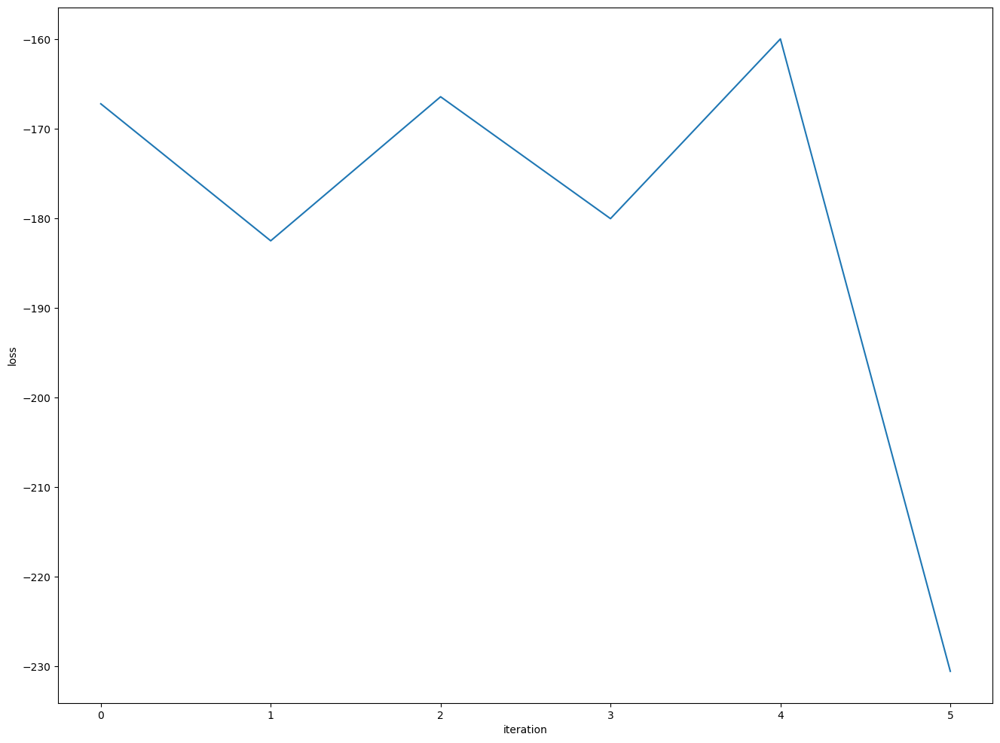

In [69]:
plt.figure(figsize=(16,12))
plt.plot(loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.png")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.eps")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.pdf")

Text(0, 0.5, 'loss')

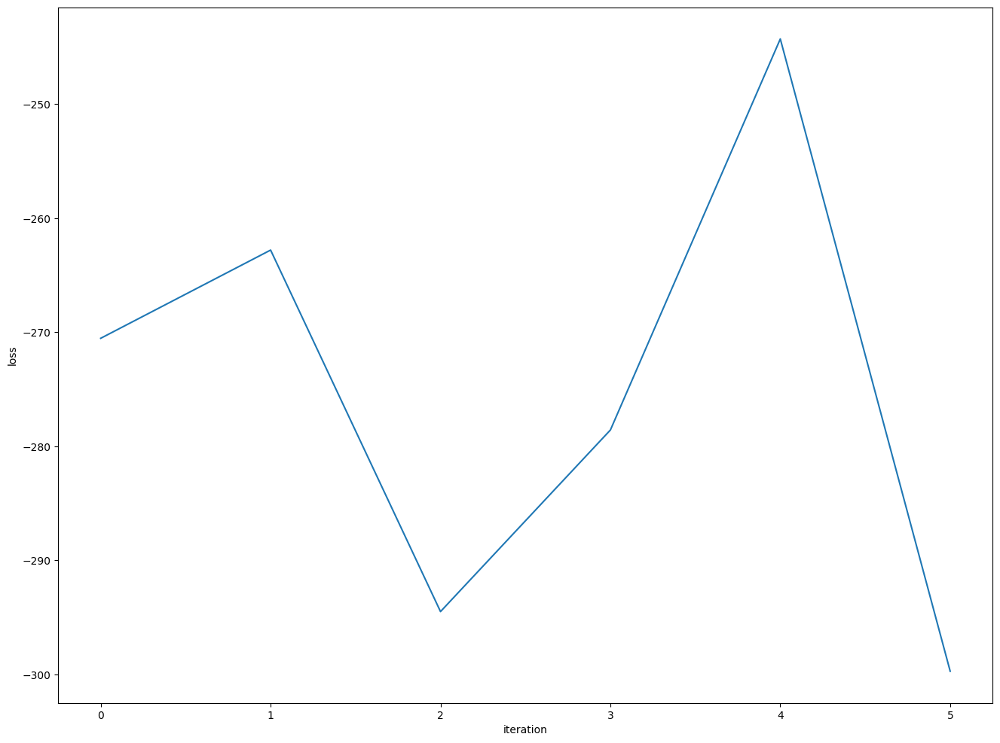

In [70]:
normalized_loss_array = np.array(normalized_loss_list)
plt.figure(figsize=(16,12))
plt.plot(normalized_loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")